In [4]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

# from keras.utils import to_categorical
from keras.preprocessing.image import img_to_array
from keras.models import Sequential
from keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, Input, Reshape, UpSampling2D

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report

import nibabel as nib

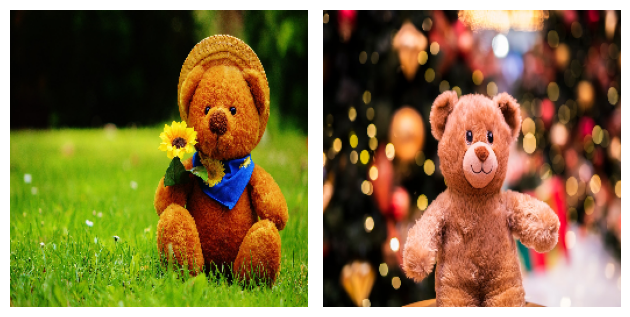

In [3]:
def process_bear(path):
    img_data = []

    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (SIZE, SIZE))
    img_data.append(img_to_array(img))
    img_array = np.reshape(img_data, (len(img_data), SIZE, SIZE, 3))
    img_array = img_array.astype("float32") / 255
    return img, img_array

def plot_images(images):
    image_count = len(images)
    for i in range(image_count):
        plt.subplot(1, image_count, i+1)
        plt.imshow(images[i])
        plt.axis(False)
    plt.tight_layout()
    plt.show()


SIZE = 256
img, img_array = process_bear("../../Data/Temp/bear.jpg")
img2, img_array2 = process_bear("../../Data/Temp/bear2.jpg")
plot_images([img, img2])

In [46]:
file_path = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S0413\ses-M132\anat\sub-ADNI002S0413_ses-M132_T1w.nii.gz"
img = nib.load(file_path) # Load the NIfTI file
img_data = img.get_fdata() # Get the image data as a NumPy array

print(f"Image shape: {img_data.shape}") # Print shape to understand the dimensions

Image shape: (176, 240, 256)


In [25]:
# Plot slices from different axes
def plot_slices(data, count=5, axis=0, transpose=True):
    """Plot slices along a specified axis."""
    slices = data.shape[axis]
    fig, axes = plt.subplots(1, count, figsize=(15, 5))
    slice_indices = np.linspace(0, slices - 1, count, dtype=int)  # Choose 5 slices
    
    for i, idx in enumerate(slice_indices):
        if axis == 0:
            slice_data = data[idx, :, :]
        elif axis == 1:
            slice_data = data[:, idx, :]
        else:
            slice_data = data[:, :, idx]
        
        if transpose:
            axes[i].imshow(slice_data.T, cmap="gray", origin="lower")  # Transpose for correct orientation
        else:
            axes[i].imshow(slice_data, cmap="gray")  # Transpose for correct orientation
        axes[i].set_title(f"Slice {idx}")
        axes[i].axis("off")
    
    plt.show()

# Plot slices along each axis
plot_slices(img_data, count=5, axis=0)  # Axial slices
plot_slices(img_data, count=5, axis=1)  # Coronal slices
plot_slices(img_data, count=5, axis=2)  # Sagittal slices


NameError: name 'img_data' is not defined

In [26]:
def plot_image_grid(data, grid_size = 10, axis=0):
    """Plot 100 slices along axis=0 in a 10x10 grid."""
    slices = data.shape[axis]
    
    # Ensure we have enough slices; otherwise, pad with empty slices
    slice_indices = np.linspace(0, slices - 1, grid_size**2, dtype=int)

    fig, axes = plt.subplots(grid_size, grid_size, figsize=(15, 15))
    #fig.subplots_adjust(wspace=0.1, hspace=0.1)  # Adjust spacing between plots

    for i, ax in enumerate(axes.flat):
        if i < len(slice_indices):
            idx = slice_indices[i]
            slice_data = data[idx, :, :]  # Extract slice along axis=0
            ax.imshow(slice_data.T, cmap="gray", origin="lower")  # Transpose for orientation
            ax.set_title(f"Slice {idx}", fontsize=8)
        else:
            ax.axis("off")  # Turn off axes if no slice is available
        ax.axis("off")  # Hide axes

    plt.tight_layout()
    plt.show()

plot_image_grid(img_data, grid_size=7, axis=0)

NameError: name 'img_data' is not defined

In [78]:
"""
import os
import nibabel as nib
import numpy as np

# Function to load all NIfTI files from the given root directory
def load_nifti_images(root_dir):
    images = []
    # Traverse the directory structure
    for root, dirs, files in os.walk(root_dir):
        for file in files:
            if file.endswith('.nii.gz'):
                # Build full file path
                file_path = os.path.join(root, file)
                print(f"Loading: {file_path}")
                
                # Load NIfTI image
                img = nib.load(file_path)
                img_data = img.get_fdata()
                images.append(img_data)
    return images
root_directory = r"C:\\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids"
images = load_nifti_images(root_directory) # Load all NIfTI images

# Convert the list of images to a NumPy array (optional, depending on how you want to process them)
images_array = np.array(images)

# Print the shape of the loaded images (this is just an example, adjust based on your needs)
print(f"Loaded {len(images)} images with shape: {images_array.shape}")

# Now images_array contains all the loaded NIfTI image data from the sessions and subjects.
"""

'\nimport os\nimport nibabel as nib\nimport numpy as np\n\n# Function to load all NIfTI files from the given root directory\ndef load_nifti_images(root_dir):\n    images = []\n    # Traverse the directory structure\n    for root, dirs, files in os.walk(root_dir):\n        for file in files:\n            if file.endswith(\'.nii.gz\'):\n                # Build full file path\n                file_path = os.path.join(root, file)\n                print(f"Loading: {file_path}")\n                \n                # Load NIfTI image\n                img = nib.load(file_path)\n                img_data = img.get_fdata()\n                images.append(img_data)\n    return images\nroot_directory = r"C:\\Users\\kiran\\Documents\\_UIS\\sem6\\BACH\\Data\x08ids"\nimages = load_nifti_images(root_directory) # Load all NIfTI images\n\n# Convert the list of images to a NumPy array (optional, depending on how you want to process them)\nimages_array = np.array(images)\n\n# Print the shape of the loaded im

## XDD (ran out of memeory)
hhahaha, akkurat som å optimize trading strategier jo

428 / 522 filer tho, so fukin closee man.

Men vi skal jo trene på friske hjerner (255 bilder??) så kanskje d går på egen pc allikvel :joy:

(ellers.. batches?)

In [79]:
def load_n1_to_n2_nifti_images(root_dir, n1, n2):
    # Function to load NIfTI files from the given root directory in the range n1 to n2
    images = []
    image_count = 0
    
    # Traverse the directory structure
    for root, dirs, files in os.walk(root_dir):
        for file in files:
            if file.endswith('.nii.gz'):
                # Build full file path
                file_path = os.path.join(root, file)
                print(f"Loading: {file_path}")
                
                # Load NIfTI image
                img = nib.load(file_path)
                img_data = img.get_fdata()
                
                # Add the image to the list if it's within the specified range
                if n1 <= image_count < n2:
                    images.append(img_data)
                
                image_count += 1
                
                # Stop if we've loaded n2 images
                if image_count >= n2:
                    return images
    
    return images

root_directory = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids"

images = load_n1_to_n2_nifti_images(root_directory, 5, 15) # Load images from n1 to n2

# Convert the list of images to a NumPy array (optional, depending on how you want to process them)
#images_array = np.array(images)
for i, image in enumerate(images):
    print(i, len(image))

# Print the shape of the loaded images (this is just an example, adjust based on your needs)
#print(f"Loaded {len(images)} images with shape: {images_array.shape}")

# Now images_array contains the first 10 loaded NIfTI image data from the sessions and subjects.


Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S0413\ses-M132\anat\sub-ADNI002S0413_ses-M132_T1w.nii.gz
Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S0413\ses-M162\anat\sub-ADNI002S0413_ses-M162_T1w.nii.gz
Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S1261\ses-M120\anat\sub-ADNI002S1261_ses-M120_T1w.nii.gz
Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S1261\ses-M132\anat\sub-ADNI002S1261_ses-M132_T1w.nii.gz
Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S1261\ses-M144\anat\sub-ADNI002S1261_ses-M144_T1w.nii.gz
Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S1280\ses-M120\anat\sub-ADNI002S1280_ses-M120_T1w.nii.gz
Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S1280\ses-M144\anat\sub-ADNI002S1280_ses-M144_T1w.nii.gz
Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S4213\ses-M072\anat\sub-ADNI002S4213_ses-

In [63]:
#plot_image_grid(images, grid_size=2, axis=0)

AttributeError: 'list' object has no attribute 'shape'

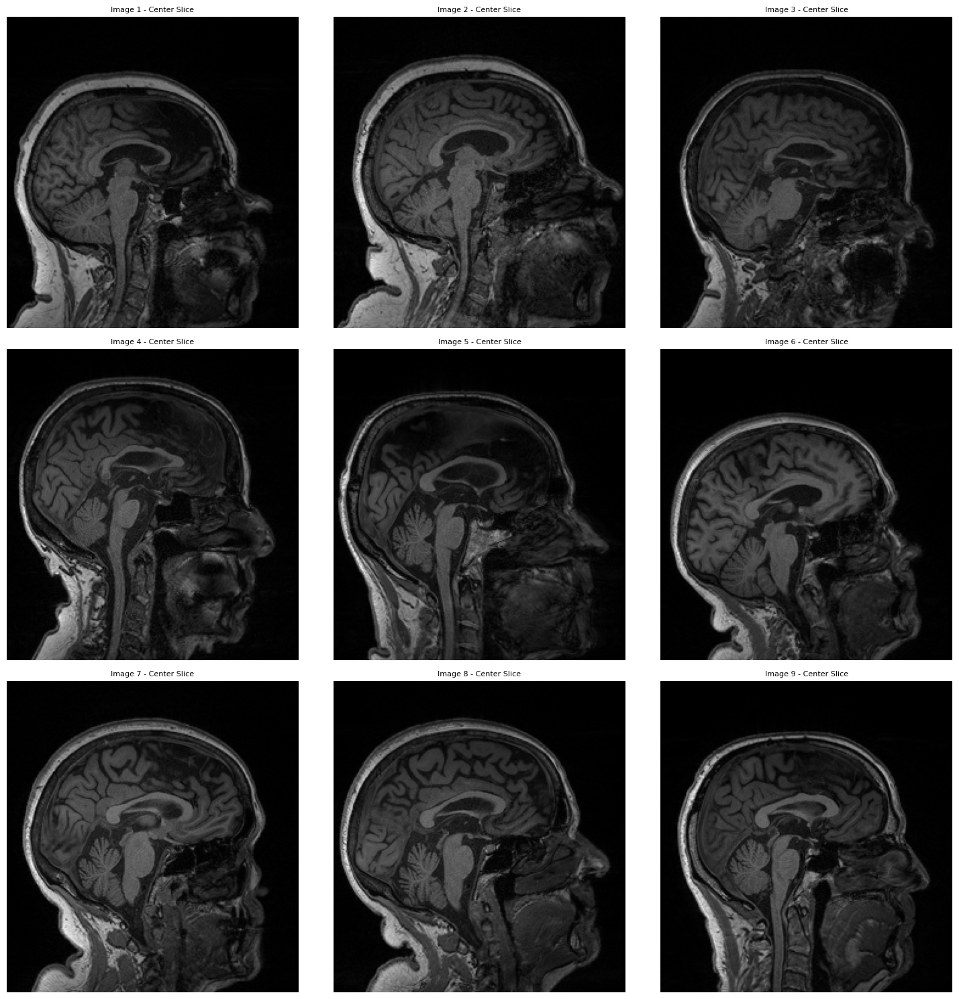

In [88]:
def plot_center_slices(images, x_size, y_size):
    # Calculate the grid size based on number of images
    rows = y_size
    cols = x_size
    
    # Create a subplot grid
    fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
    axes = axes.flatten()

    for i, image in enumerate(images):
        if i >= len(axes):
            break  # Exit if we run out of axes

        # Calculate the middle slice along the first axis (axis=0)
        center_slice_idx = image.shape[0] // 2
        center_slice = image[center_slice_idx, :, :]  # Slice along axis=0
        
        # Plot the center slice
        ax = axes[i]
        ax.imshow(center_slice.T, cmap="gray", origin="lower")  # Transpose for correct orientation
        ax.set_title(f"Image {i + 1} - Center Slice", fontsize=8)
        ax.axis("off")  # Hide axes
    
    # Turn off any unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis("off")
    
    plt.tight_layout()
    plt.show()

# Plot the center slices of the images
plot_center_slices(images, x_size=3, y_size=3)

**Ketil kommentar:**

Jeg har preprosessert bildene for dere så dere slipper å gjøre det..??! What!

**Problemer:**

- Bildene er ikke sentrert på aksene (midten av hjernen burde være i midterste indeks), bildene bør forskyves da
- Hjernene er ikke rotert (curve fittet til forventning)
- Posisjon på hodene er ikke i midten av bildet (også curve fittes)
- Hjernene er heller ikke extractet fra skallen

**PriorityQueue:**

- Preprocessing
- AU
- VAU
- GAN

**Installing fsinstaller (from the first article Alcoholism Detection by Data Augmentation and Convolutional Neural Network with Stochastic Pooling:)**
1. https://fsl.fmrib.ox.ac.uk/fsl/docs/#/
2. ubuntu> python3 "/mnt/c/Users/kiran/Downloads/fslinstaller.py"
3. Placing all images in a single folder (two folders `176` and `208`)

/data/176/

- sub-ADNI002S0413_ses-M132_T1w.nii.gz
- sub-ADNI003S0906_ses-M134_T1w.nii.gz
    ...

/data/208/
    ..

4. Running below code: `preprocess_mri.sh`

In [90]:
#!/bin/bash

# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176"       # Directory with your .nii.gz files
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_176"   # Directory to save preprocessed images

TEMPLATE="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176/0_sub-ADNI002S0413_ses-M132_T1w.nii.gz"  # MNI template path
# Create output directory if it doesn't exist
mkdir -p "$OUTPUT_DIR"

# Loop over all .nii.gz files in the input directory
for FILE in "$INPUT_DIR"/*.nii.gz; do
    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    
    # 1. Skull stripping using BET
    bet "$FILE" "$OUTPUT_DIR/${BASENAME}_brain" -f 0.5 -g 0 -m
    
    # 2. Bias field correction using FAST
    fast -B "$OUTPUT_DIR/${BASENAME}_brain.nii.gz"
    
    # 3. Spatial normalization using FLIRT
    flirt -in "$OUTPUT_DIR/${BASENAME}_brain_restore.nii.gz" \
          -ref "$TEMPLATE" \
          -out "$OUTPUT_DIR/${BASENAME}_norm" \
          -omat "$OUTPUT_DIR/${BASENAME}_norm.mat"
    
    # 4. Resampling to isotropic 2mm voxel size
    fslmaths "$OUTPUT_DIR/${BASENAME}_norm.nii.gz" \
             -subsamp2 "$OUTPUT_DIR/${BASENAME}_resampled"
    
    echo "Finished processing: $BASENAME"
done

echo "All images processed. Results are in: $OUTPUT_DIR"



# Make the script executable:
# chmod +x preprocess_mri.sh

# Run the script
# ./preprocess_mri.sh 

SyntaxError: invalid syntax (1365207937.py, line 9)

In [111]:
#Somewhat ineffective, but it does the job
def load_and_save_nifti_images(root_dir, n1, n2, output_dir_176, output_dir_208):
    # Ensure output directories exist
    os.makedirs(output_dir_176, exist_ok=True)
    os.makedirs(output_dir_208, exist_ok=True)

    image_count = 0  # Counter to track how many images have been processed
    
    # Traverse the directory structure
    for root, dirs, files in os.walk(root_dir):
        for file in files:
            if file.endswith('.nii.gz'):
                # Build full file path
                file_path = os.path.join(root, file)
                print(f"Loading: {file_path}")
                
                # Load NIfTI image
                img = nib.load(file_path)
                img_data = img.get_fdata()
                
                # Process the image if it's within the specified range
                if n1 <= image_count < n2:
                    # Determine the output directory based on image length
                    if img_data.shape[0] == 176:
                        output_path = os.path.join(output_dir_176, f"{image_count}_{file}")
                    elif img_data.shape[0] == 208:
                        output_path = os.path.join(output_dir_208, f"{image_count}_{file}")
                    else:
                        print(f"Skipping image {file} due to unexpected shape: {img_data.shape}")
                        continue

                    # Save the image to the appropriate folder
                    nib.save(img, output_path)
                    print(f"Saved: {output_path}")
                
                image_count += 1
                
                # Stop if we've processed up to n2 images
                if image_count >= n2:
                    return
    
    print(f"Processing completed. Processed {image_count - n1} images in total.")

# Input and output directories
root_directory = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids"
output_directory_176 = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\176"
output_directory_208 = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\208"

# Load and save images from n1 to n2
load_and_save_nifti_images(root_directory, 0, 3000, output_directory_176, output_directory_208)


Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S0413\ses-M132\anat\sub-ADNI002S0413_ses-M132_T1w.nii.gz
Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S0413\ses-M162\anat\sub-ADNI002S0413_ses-M162_T1w.nii.gz
Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S1261\ses-M120\anat\sub-ADNI002S1261_ses-M120_T1w.nii.gz
Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S1261\ses-M132\anat\sub-ADNI002S1261_ses-M132_T1w.nii.gz
Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S1261\ses-M144\anat\sub-ADNI002S1261_ses-M144_T1w.nii.gz
Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S1280\ses-M120\anat\sub-ADNI002S1280_ses-M120_T1w.nii.gz
Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S1280\ses-M144\anat\sub-ADNI002S1280_ses-M144_T1w.nii.gz
Loading: C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\bids\sub-ADNI002S4213\ses-M072\anat\sub-ADNI002S4213_ses-

KeyboardInterrupt: 

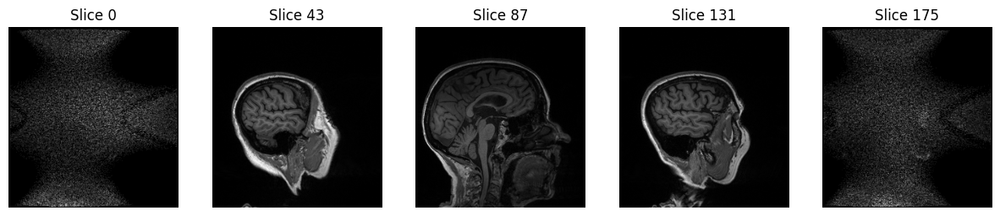

In [96]:
import nibabel as nib
import matplotlib.pyplot as plt

# Load the NIfTI file
#file_path = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\176\137_sub-ADNI014S4576_ses-M090_T1w.nii.gz"
file_path = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\176\0_sub-ADNI002S0413_ses-M132_T1w.nii.gz"
img = nib.load(file_path)  # Load the NIfTI file
img_data = img.get_fdata()  # Get the image data as a NumPy array

plot_slices(img_data, count=5, axis=0)  # Axial slices

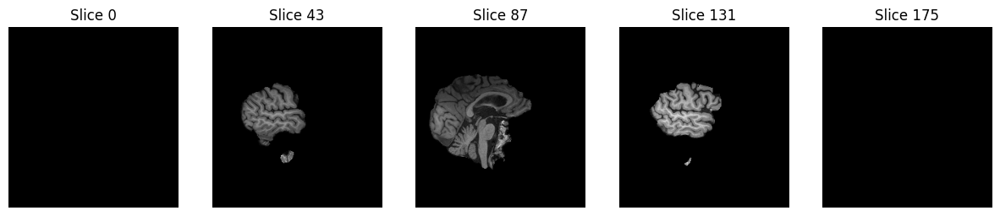

In [97]:
file_path = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc0\0_sub-ADNI002S0413_ses-M132_T1w_brain.nii.gz"
img = nib.load(file_path)  # Load the NIfTI file
img_data = img.get_fdata()  # Get the image data as a NumPy array

plot_slices(img_data, count=5, axis=0)  # Axial slices
# 0_sub-ADNI002S0413_ses-M132_T1w_brain_mask.nii.gz

### YIKES WE CUT TOO MUCH OF THE BRAIN, LOWERING THE THRESHOLD NEXT:

In [ ]:
bet "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176/0_sub-ADNI002S0413_ses-M132_T1w.nii.gz" \
    "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/pre_proc1/0_sub-ADNI002S0413_ses-M132_T1w_brain" \
    -f 0.3 -g 0 -m


In [24]:
def plot_by_path(path, count=5, axis=0, transpose=True):
    img = nib.load(path)  # Load the NIfTI file
    img_data = img.get_fdata()  # Get the image data as a NumPy array

    plot_slices(img_data, count=count, axis=axis, transpose=transpose)  # Axial slices
    # 0_sub-ADNI002S0413_ses-M132_T1w_brain_mask.nii.gz
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc1\0_sub-ADNI002S0413_ses-M132_T1w_brain.nii.gz")

NameError: name 'plot_slices' is not defined

#### TOO LITTLE! (THATS WHAT SHE SAID)

bet "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176/0_sub-ADNI002S0413_ses-M132_T1w.nii.gz" \
    "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/pre_proc2/0_sub-ADNI002S0413_ses-M132_T1w_brain" \
    -f 0.4 -g 0 -m
bet "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176/2_sub-ADNI002S1261_ses-M120_T1w.nii.gz" \
    "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/pre_proc2/2_sub-ADNI002S1261_ses-M120_T1w_brain" \
    -f 0.4 -g 0 -m

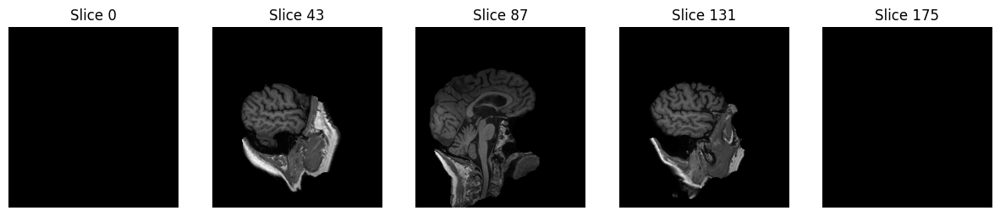

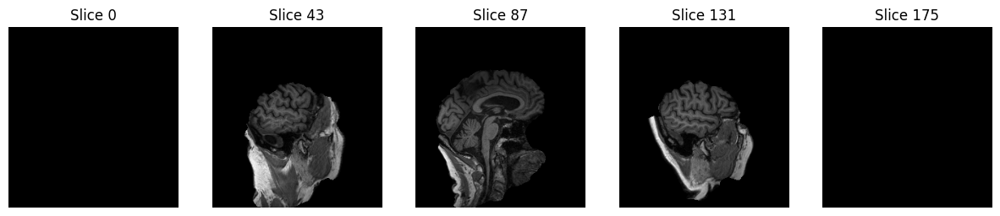

In [102]:
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc2\0_sub-ADNI002S0413_ses-M132_T1w_brain.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc2\2_sub-ADNI002S1261_ses-M120_T1w_brain.nii.gz")

bet "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176/0_sub-ADNI002S0413_ses-M132_T1w.nii.gz" \
    "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/pre_proc3/0_sub-ADNI002S0413_ses-M132_T1w_brain" \
    -f 0.48 -g 0 -m
bet "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176/2_sub-ADNI002S1261_ses-M120_T1w.nii.gz" \
    "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/pre_proc3/2_sub-ADNI002S1261_ses-M120_T1w_brain" \
    -f 0.48 -g 0 -m

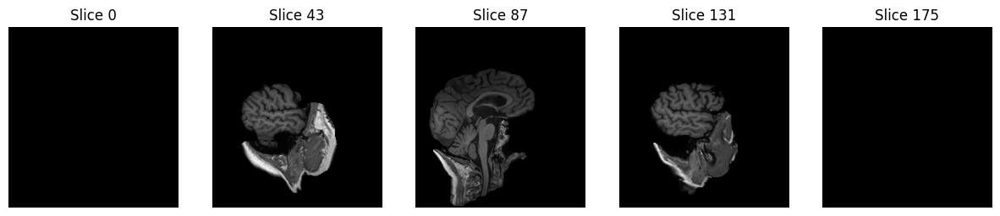

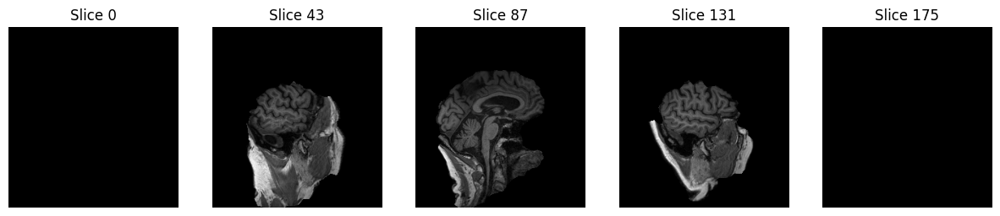

In [104]:
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc3\0_sub-ADNI002S0413_ses-M132_T1w_brain.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc3\2_sub-ADNI002S1261_ses-M120_T1w_brain.nii.gz")

bet "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176/0_sub-ADNI002S0413_ses-M132_T1w.nii.gz" \
    "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/pre_proc4/0_sub-ADNI002S0413_ses-M132_T1w_brain" \
    -f 0.48 -g 0 -m
bet "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176/2_sub-ADNI002S1261_ses-M120_T1w.nii.gz" \
    "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/pre_proc4/2_sub-ADNI002S1261_ses-M120_T1w_brain" \
    -f 0.48 -g 0 -m

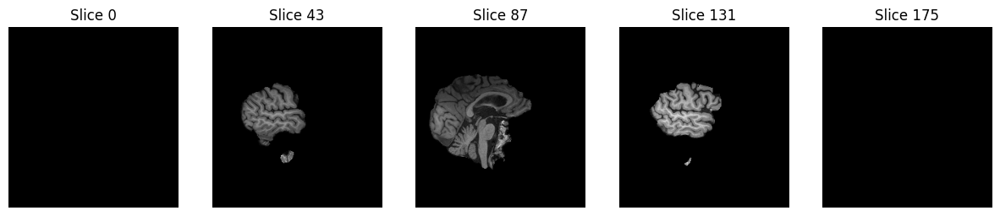

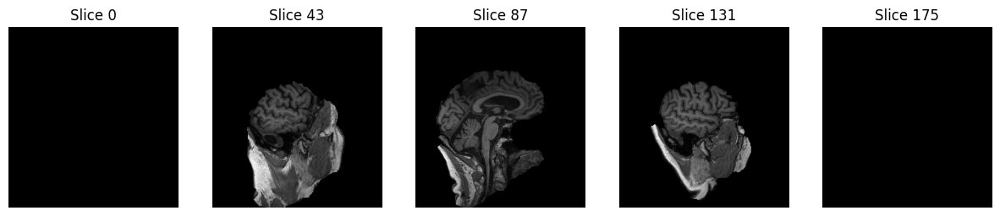

In [107]:
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc4\0_sub-ADNI002S0413_ses-M132_T1w_brain.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc4\2_sub-ADNI002S1261_ses-M120_T1w_brain.nii.gz")

well fuck it, lets just go by the default 0.5

bet "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176/0_sub-ADNI002S0413_ses-M132_T1w.nii.gz" \
    "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/pre_proc5/0_sub-ADNI002S0413_ses-M132_T1w_brain" \
    -f 0.5 -g 0 -m
bet "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176/2_sub-ADNI002S1261_ses-M120_T1w.nii.gz" \
    "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/pre_proc5/2_sub-ADNI002S1261_ses-M120_T1w_brain" \
    -f 0.5 -g 0 -m

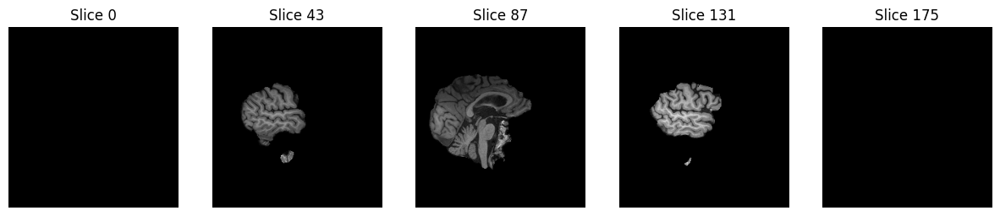

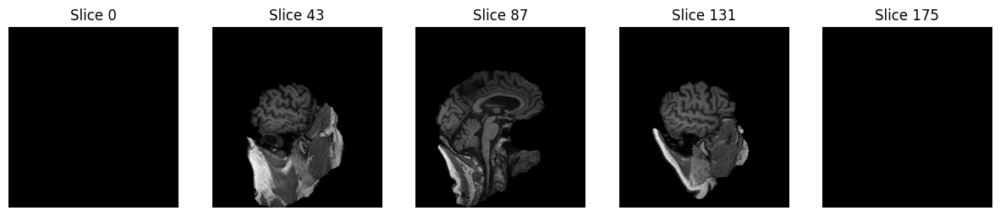

In [108]:
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\0_sub-ADNI002S0413_ses-M132_T1w_brain.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\2_sub-ADNI002S1261_ses-M120_T1w_brain.nii.gz")

In [ ]:
#!/bin/bash

# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176"       # Directory with your .nii.gz files
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/pre_proc5"   # Directory to save preprocessed images

TEMPLATE="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176/0_sub-ADNI002S0413_ses-M132_T1w.nii.gz"  # MNI template path
# Create output directory if it doesn't exist
mkdir -p "$OUTPUT_DIR"

# List of specific files to process
FILES_TO_PROCESS=("5_sub-ADNI002S1280_ses-M120_T1w.nii.gz" "2_sub-ADNI002S1261_ses-M120_T1w.nii.gz")

# Loop over the specific files to process
for FILE in "${FILES_TO_PROCESS[@]}"; do
    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    
    # Full input file path
    FILE_PATH="$INPUT_DIR/$FILE"

    # 1. Skull stripping using BET
    bet "$FILE_PATH" "$OUTPUT_DIR/${BASENAME}_brain" -f 0.5 -g 0 -m
    
    # 2. Bias field correction using FAST
    fast -B "$OUTPUT_DIR/${BASENAME}_brain.nii.gz"
    
    # 3. Spatial normalization using FLIRT
    flirt -in "$OUTPUT_DIR/${BASENAME}_brain_restore.nii.gz" \
          -ref "$TEMPLATE" \
          -out "$OUTPUT_DIR/${BASENAME}_norm" \
          -omat "$OUTPUT_DIR/${BASENAME}_norm.mat"
    
    # 4. Resampling to isotropic 2mm voxel size
    fslmaths "$OUTPUT_DIR/${BASENAME}_norm.nii.gz" \
             -subsamp2 "$OUTPUT_DIR/${BASENAME}_resampled"
    
    echo "Finished processing: $BASENAME"
done

echo "Selected images processed. Results are in: $OUTPUT_DIR"


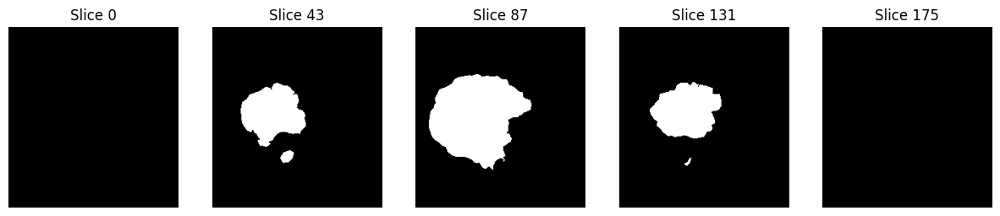

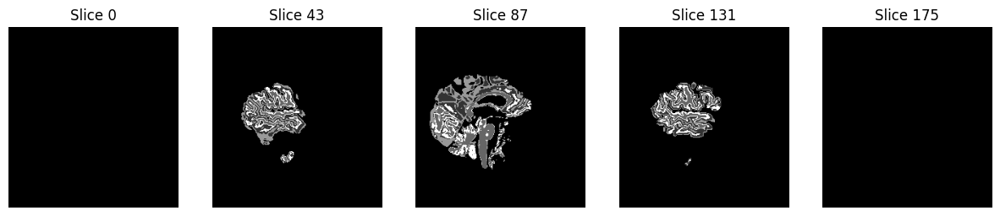

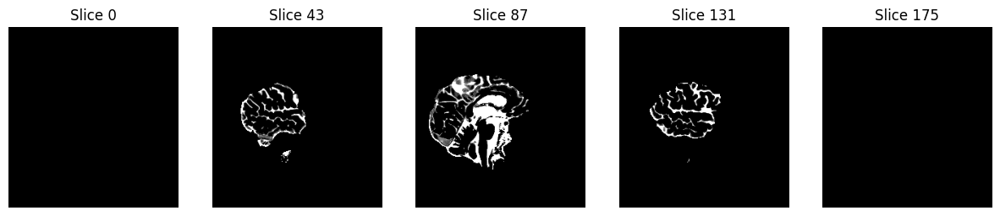

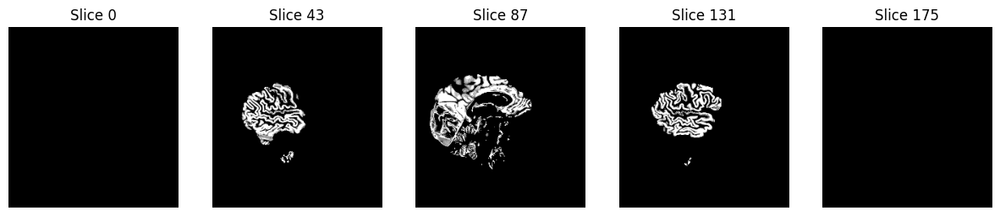

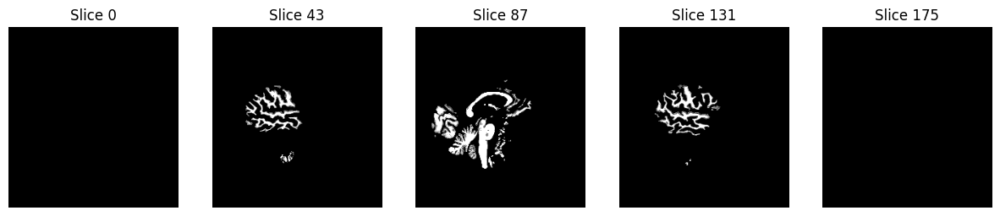

...

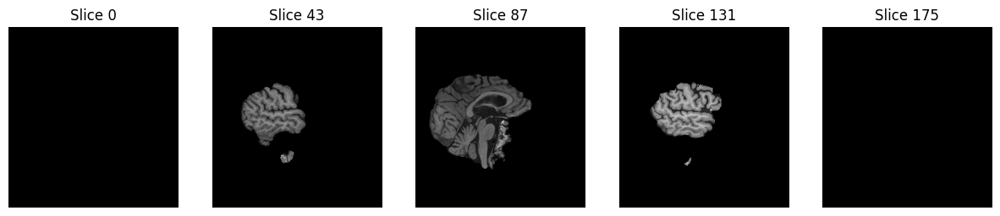

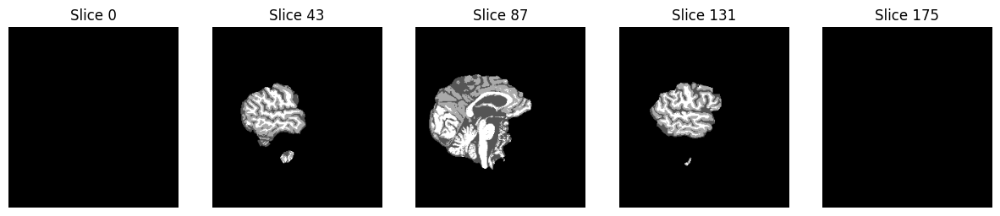

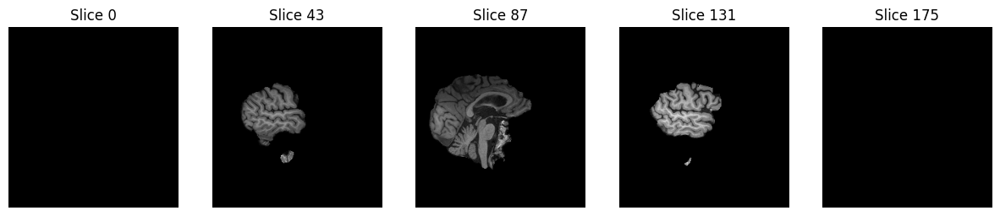

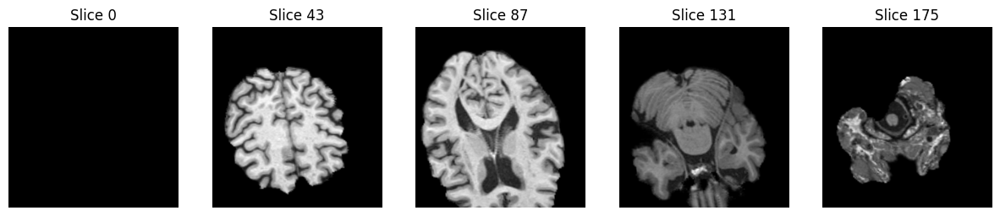

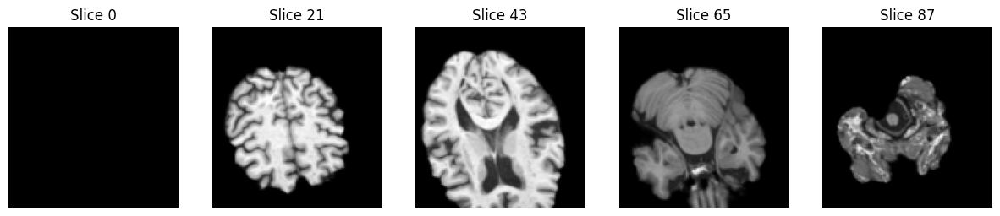

In [118]:
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\0_sub-ADNI002S0413_ses-M132_T1w_brain_mask.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\0_sub-ADNI002S0413_ses-M132_T1w_brain_mixeltype.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\0_sub-ADNI002S0413_ses-M132_T1w_brain_pve_0.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\0_sub-ADNI002S0413_ses-M132_T1w_brain_pve_1.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\0_sub-ADNI002S0413_ses-M132_T1w_brain_pve_2.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\0_sub-ADNI002S0413_ses-M132_T1w_brain_pveseg.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\0_sub-ADNI002S0413_ses-M132_T1w_brain_restore.nii.gz")

plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\0_sub-ADNI002S0413_ses-M132_T1w_brain_seg.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\0_sub-ADNI002S0413_ses-M132_T1w_brain.nii.gz")
# plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\0_sub-ADNI002S0413_ses-M132_T1w_norm.mat.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\0_sub-ADNI002S0413_ses-M132_T1w_norm.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\0_sub-ADNI002S0413_ses-M132_T1w_resampled.nii.gz")



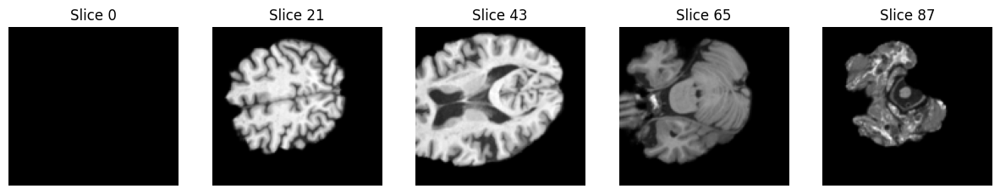

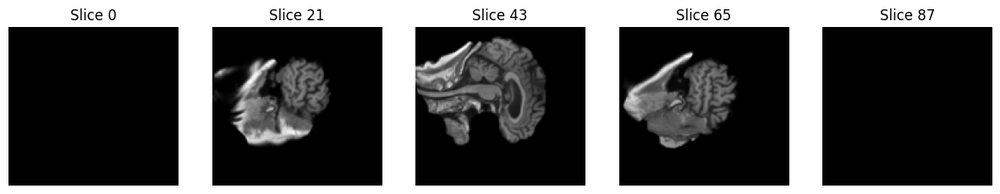

In [157]:
# file_path = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\176\0_sub-ADNI002S0413_ses-M132_T1w.nii.gz"
# file_path = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\176\137_sub-ADNI014S4576_ses-M090_T1w.nii.gz"
file_path0 = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\0_sub-ADNI002S0413_ses-M132_T1w_resampled.nii.gz"
file_path2 = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\2_sub-ADNI002S1261_ses-M120_T1w_resampled.nii.gz"

img0 = nib.load(file_path0)
img2 = nib.load(file_path2)
img_data0 = img0.get_fdata()
img_data2 = img2.get_fdata()

plot_slices(img_data0, count=5, axis=0, transpose=False)
plot_slices(img_data2, count=5, axis=0, transpose=False)

TIME TO GIVE UP :SOB:

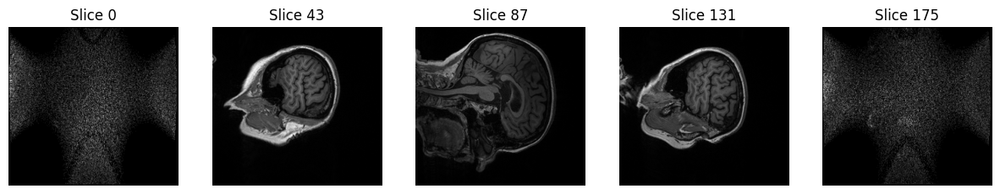

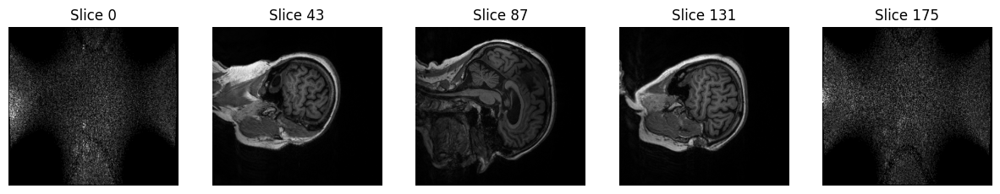

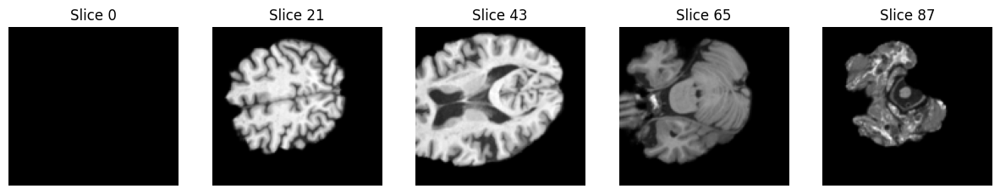

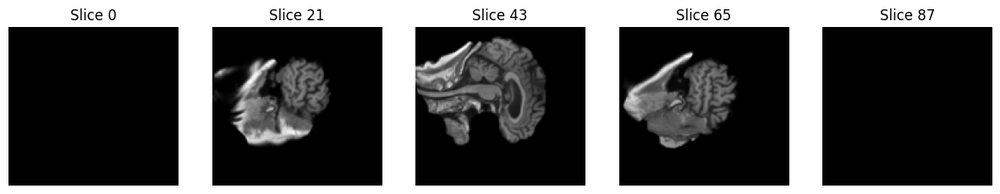

In [161]:
file_unp0 = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\176\0_sub-ADNI002S0413_ses-M132_T1w.nii.gz"
file_unp2 = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\176\2_sub-ADNI002S1261_ses-M120_T1w.nii.gz"

file_path0 = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\0_sub-ADNI002S0413_ses-M132_T1w_resampled.nii.gz"
file_path2 = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc5\2_sub-ADNI002S1261_ses-M120_T1w_resampled.nii.gz"

img0 = nib.load(file_unp0)
img2 = nib.load(file_unp2)
img3 = nib.load(file_path0)
img4 = nib.load(file_path2)

img_data0 = img0.get_fdata()
img_data2 = img2.get_fdata()
img_data3 = img3.get_fdata()
img_data4 = img4.get_fdata()

plot_slices(img_data0, count=5, axis=0, transpose=False)
plot_slices(img_data2, count=5, axis=0, transpose=False)

plot_slices(img_data3, count=5, axis=0, transpose=False)
plot_slices(img_data4, count=5, axis=0, transpose=False)

##### For some weird af reason, the images are not as they should be. It might be the teacher actually did preprocess (do rotations etc, and I should really have just fed the raw data to the program instead of the teacher's images, but we can also just remove this rotation step somewhere in the code, debugging next)

(88, 120, 128) (88, 120, 128)
[[   2.39999986    0.            0.         -104.3999939 ]
 [   0.            2.109375      0.         -126.5625    ]
 [   0.            0.            2.109375   -135.        ]
 [   0.            0.            0.            1.        ]]
[[   2.39999986    0.            0.         -104.3999939 ]
 [   0.            2.109375      0.         -126.5625    ]
 [   0.            0.            2.109375   -135.        ]
 [   0.            0.            0.            1.        ]]


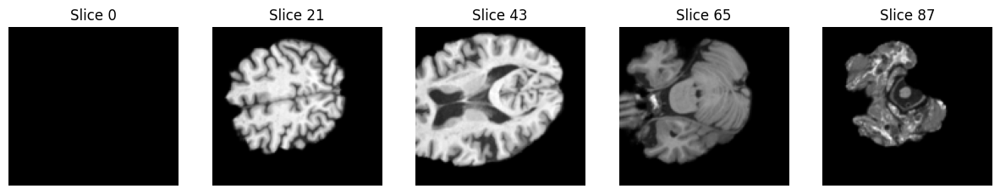

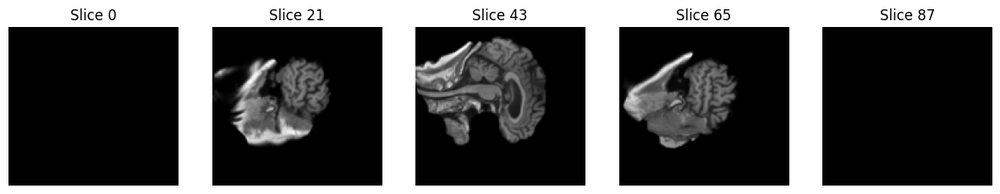

In [165]:
print(img_data3.shape, img_data4.shape)
print(img3.affine)  # Check the affine matrix for the resampled image
print(img4.affine)  # Check the affine matrix for the resampled image
img3 = nib.as_closest_canonical(img3)  # Reorient to the closest canonical orientation
img4 = nib.as_closest_canonical(img4)  # Reorient to the closest canonical orientation
plot_slices(img_data3, count=5, axis=0, transpose=False)
plot_slices(img_data4, count=5, axis=0, transpose=False)

# Try swapping axes if necessary
img_data3 = img_data3.transpose(1, 0, 2)  # Swap axis 0 and 1, for example
img_data4 = img_data4.transpose(1, 0, 2)  # Swap axis 0 and 1, for example

plot_slices(img_data3, count=5, axis=0, transpose=False)
plot_slices(img_data4, count=5, axis=1, transpose=True)

### PERHAPS THIS IS BECAUSE FILES TO PROCESS CONTAINS THE TEMPLATE AS WELL, MAKING EVERYTHING BUG THE FUCK OUT AS IT IS SCREWING WITH THE TEMPLATE TOO, idfk bro, we try again? :joy:

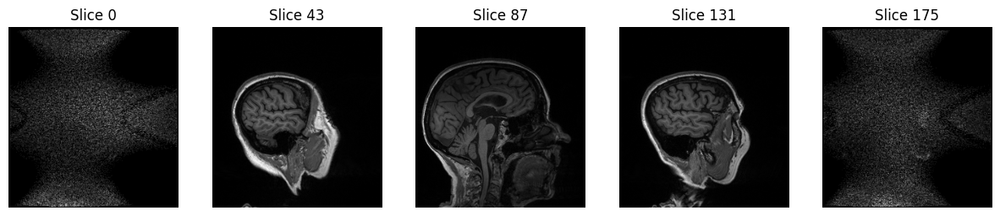

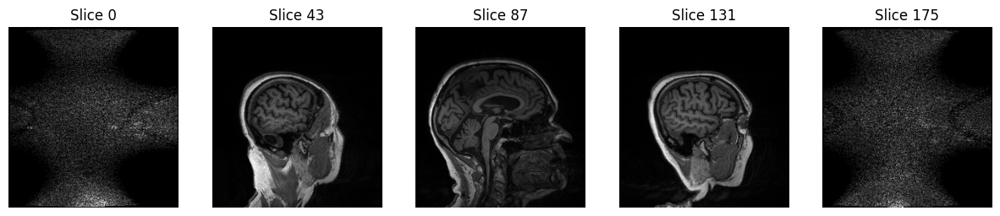

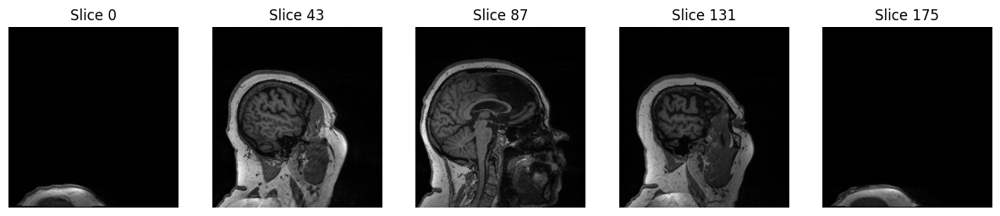

In [193]:
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\176\0_sub-ADNI002S0413_ses-M132_T1w.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\176\2_sub-ADNI002S1261_ses-M120_T1w.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\176\5_sub-ADNI002S1280_ses-M120_T1w.nii.gz")

All images here are aligned

In [ ]:
#!/bin/bash

# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176"
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/pre_proc6"
TEMPLATE="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176/0_sub-ADNI002S0413_ses-M132_T1w.nii.gz"  # MNI template path
mkdir -p "$OUTPUT_DIR" # Create output directory if it doesn't exist

# DONT FUCKING PROCESS THE TEMPLATE BRO, PERHAPS THAT HELPS?
FILES_TO_PROCESS=("2_sub-ADNI002S1261_ses-M120_T1w.nii.gz" "5_sub-ADNI002S1280_ses-M120_T1w.nii.gz")

for FILE in "${FILES_TO_PROCESS[@]}"; do
    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    
    # Full input file path
    FILE_PATH="$INPUT_DIR/$FILE"

    # 1. Skull stripping using BET
    bet "$FILE_PATH" "$OUTPUT_DIR/${BASENAME}_brain" -f 0.5 -g 0 -m
    
    # 2. Bias field correction using FAST
    fast -B "$OUTPUT_DIR/${BASENAME}_brain.nii.gz"
    
    # 3. Spatial normalization using FLIRT
    flirt -in "$OUTPUT_DIR/${BASENAME}_brain_restore.nii.gz" \
          -ref "$TEMPLATE" \
          -out "$OUTPUT_DIR/${BASENAME}_norm" \
          -omat "$OUTPUT_DIR/${BASENAME}_norm.mat"
    
    # 4. Resampling to isotropic 2mm voxel size
    fslmaths "$OUTPUT_DIR/${BASENAME}_norm.nii.gz" \
             -subsamp2 "$OUTPUT_DIR/${BASENAME}_resampled"
    
    echo "Finished processing: $BASENAME"
done

echo "Selected images processed. Results are in: $OUTPUT_DIR"


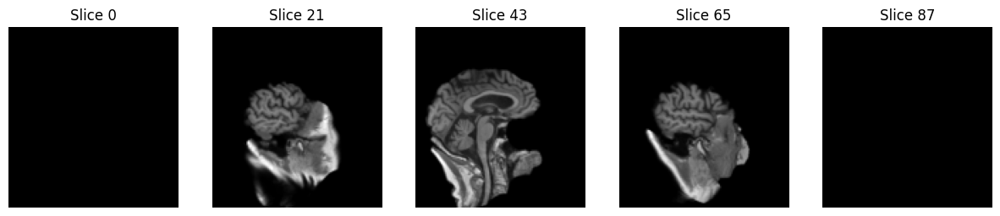

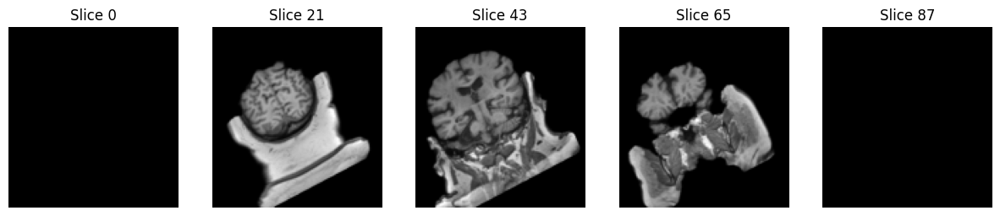

In [ ]:
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc6\2_sub-ADNI002S1261_ses-M120_T1w_resampled.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc6\5_sub-ADNI002S1280_ses-M120_T1w_resampled.nii.gz")

#### LMAO WHAT DAFUQ IS THAT SPATIAL NORMALIZATION BRO

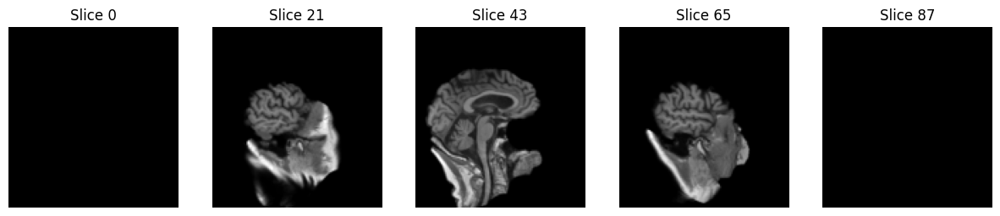

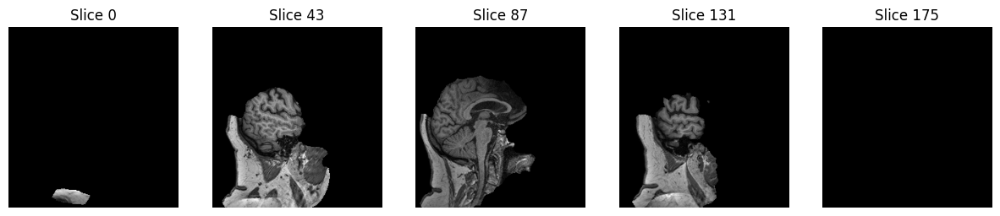

In [205]:
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc6\2_sub-ADNI002S1261_ses-M120_T1w_resampled.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc6\5_sub-ADNI002S1280_ses-M120_T1w_brain_restore.nii.gz")


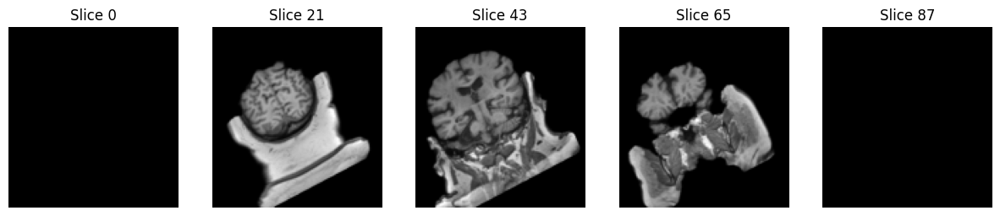

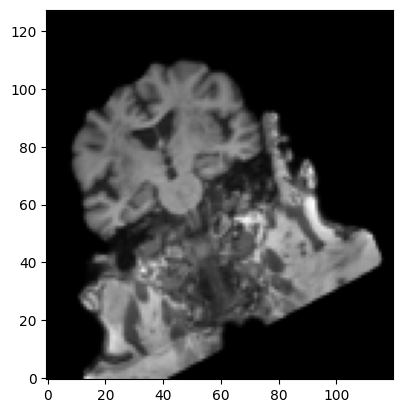

In [243]:
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc6\5_sub-ADNI002S1280_ses-M120_T1w_resampled.nii.gz")
path = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc6\5_sub-ADNI002S1280_ses-M120_T1w_resampled.nii.gz"
img = nib.load(path)  # Load the NIfTI file
img_data = img.get_fdata()  # Get the image data as a NumPy array

axis = 0
data = img_data
idx = 50

#plt.imshow(img_data.shape[0])

if axis == 0:
    slice_data = data[idx, :, :]
elif axis == 1:
    slice_data = data[:, idx, :]
else:
    slice_data = data[:, :, idx]

plt.imshow(slice_data.T, cmap="gray", origin="lower")  # Transpose for correct orientation
#plt.imshow(slice_data, cmap="gray")  # Transpose for correct orientation
#axes[i].set_title(f"Slice {idx}")
#axes[i].axis("off")

- TEST WITH 208 images instead?? (Higher resolution should work better acording to the docs)
- Download the images from the original site (we here assume the teacher did some preprocessing on the images I downloaded such as rotations, which is messing up for the program as it probably reads from the data and is like, oh okay, lets rotate it this way then, which "undoes" the rotation the teacher applied?)

In [ ]:
#!/bin/bash

# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176"
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/pre_proc7"
TEMPLATE="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176/0_sub-ADNI002S0413_ses-M132_T1w.nii.gz"  # MNI template path
mkdir -p "$OUTPUT_DIR" # Create output directory if it doesn't exist

# DONT FUCKING PROCESS THE TEMPLATE BRO, PERHAPS THAT HELPS?
FILES_TO_PROCESS=("5_sub-ADNI002S1280_ses-M120_T1w.nii.gz")

for FILE in "${FILES_TO_PROCESS[@]}"; do
    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    
    # Full input file path
    FILE_PATH="$INPUT_DIR/$FILE"

    # 1. Skull stripping using BET
    bet "$FILE_PATH" "$OUTPUT_DIR/${BASENAME}_brain" -f 0.5 -g 0 -m
    
    # 2. Bias field correction using FAST
    fast -B "$OUTPUT_DIR/${BASENAME}_brain.nii.gz"
    
    # 3. Spatial normalization using FLIRT
    flirt -in "$OUTPUT_DIR/${BASENAME}_brain_restore.nii.gz" \
          -ref "$TEMPLATE" \
          -out "$OUTPUT_DIR/${BASENAME}_norm" \
          -omat "$OUTPUT_DIR/${BASENAME}_norm.mat"
          -dof 12 \
          -cost corratio
    
    # 4. Resampling to isotropic 2mm voxel size
    fslmaths "$OUTPUT_DIR/${BASENAME}_norm.nii.gz" \
             -subsamp2 "$OUTPUT_DIR/${BASENAME}_resampled"
    
    echo "Finished processing: $BASENAME"
done

echo "Selected images processed. Results are in: $OUTPUT_DIR"



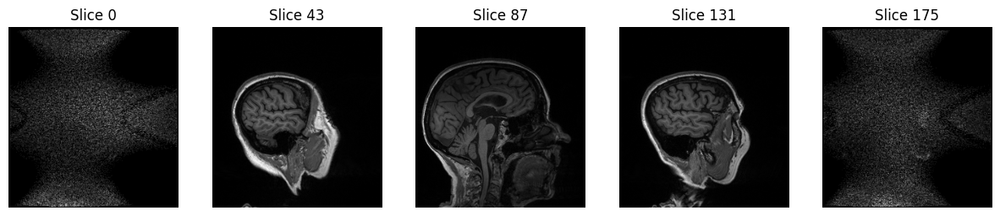

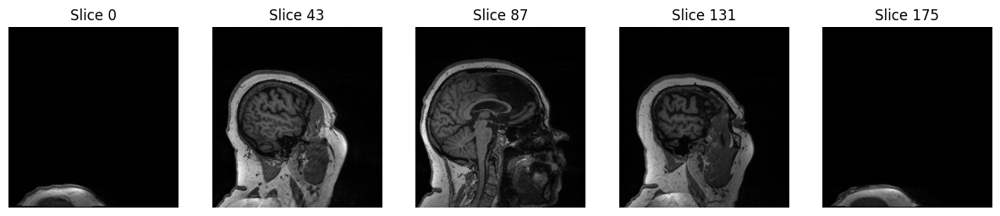

In [253]:
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\176\0_sub-ADNI002S0413_ses-M132_T1w.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\176\5_sub-ADNI002S1280_ses-M120_T1w.nii.gz")


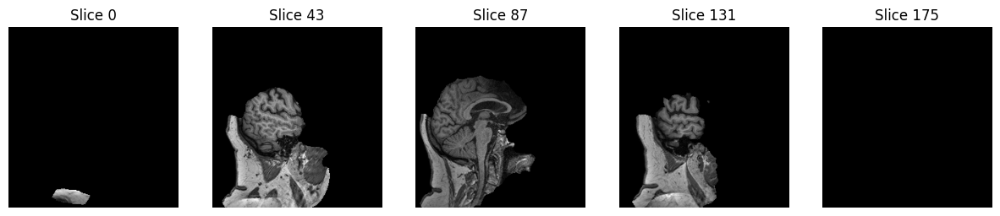

In [258]:
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc7\5_sub-ADNI002S1280_ses-M120_T1w_brain_restore.nii.gz")

In [259]:
#!/bin/bash

# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/pre_proc7"
TEMPLATE="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/1_sub-ADNI002S0413_ses-M162_T1w.nii.gz"  # MNI template path
mkdir -p "$OUTPUT_DIR" # Create output directory if it doesn't exist

# DONT FUCKING PROCESS THE TEMPLATE BRO, PERHAPS THAT HELPS?
FILES_TO_PROCESS=("3_sub-ADNI002S1261_ses-M132_T1w.nii.gz" "4_sub-ADNI002S1261_ses-M144_T1w.nii.gz")

for FILE in "${FILES_TO_PROCESS[@]}"; do
    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    
    # Full input file path
    FILE_PATH="$INPUT_DIR/$FILE"

    # 1. Skull stripping using BET
    bet "$FILE_PATH" "$OUTPUT_DIR/${BASENAME}_brain" -f 0.5 -g 0 -m
    
    # 2. Bias field correction using FAST
    fast -B "$OUTPUT_DIR/${BASENAME}_brain.nii.gz"
    
    # 3. Spatial normalization using FLIRT
    flirt -in "$OUTPUT_DIR/${BASENAME}_brain_restore.nii.gz" \
          -ref "$TEMPLATE" \
          -out "$OUTPUT_DIR/${BASENAME}_norm" \
          -omat "$OUTPUT_DIR/${BASENAME}_norm.mat"
    
    # 4. Resampling to isotropic 2mm voxel size
    fslmaths "$OUTPUT_DIR/${BASENAME}_norm.nii.gz" \
             -subsamp2 "$OUTPUT_DIR/${BASENAME}_resampled"
    
    echo "Finished processing: $BASENAME"
done

echo "Selected images processed. Results are in: $OUTPUT_DIR"


SyntaxError: invalid syntax (2389648387.py, line 7)

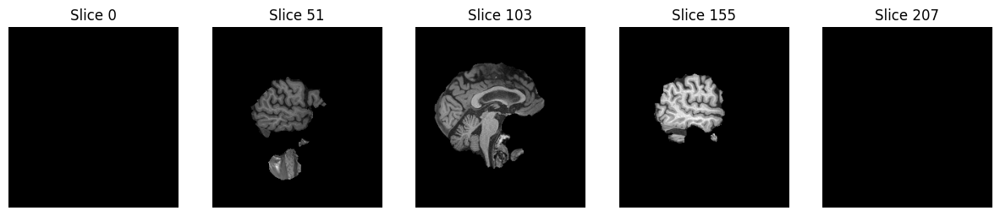

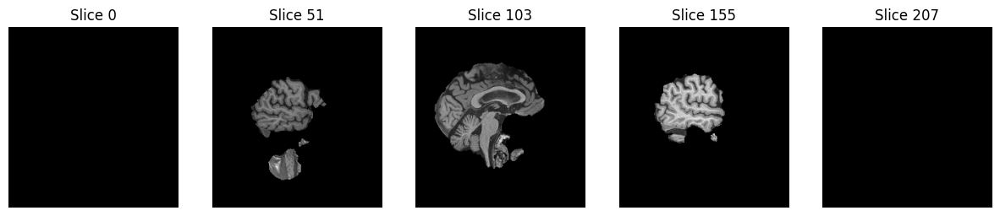

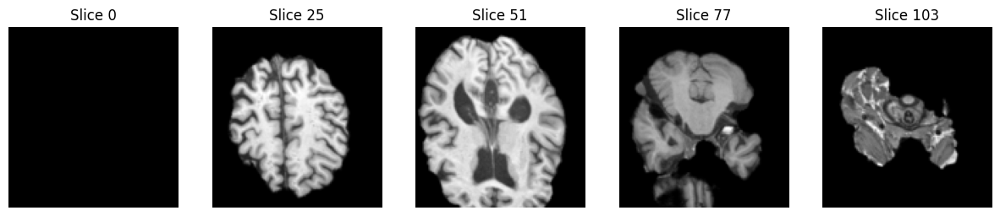

In [303]:
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc7\3_sub-ADNI002S1261_ses-M132_T1w_brain.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc7\3_sub-ADNI002S1261_ses-M132_T1w_brain_restore.nii.gz")
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc7\3_sub-ADNI002S1261_ses-M132_T1w_resampled.nii.gz")

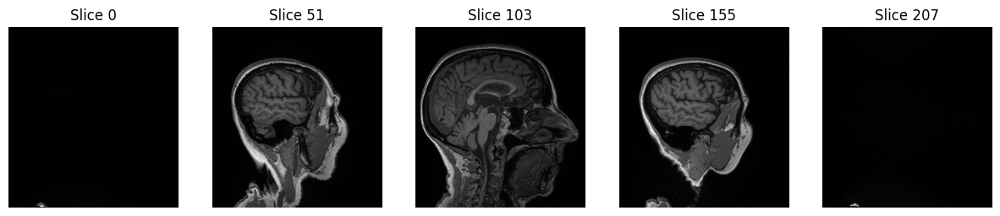

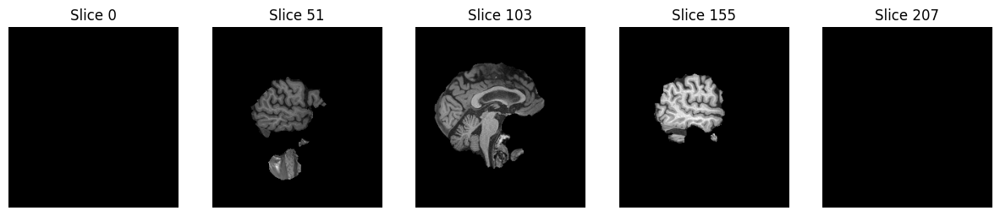

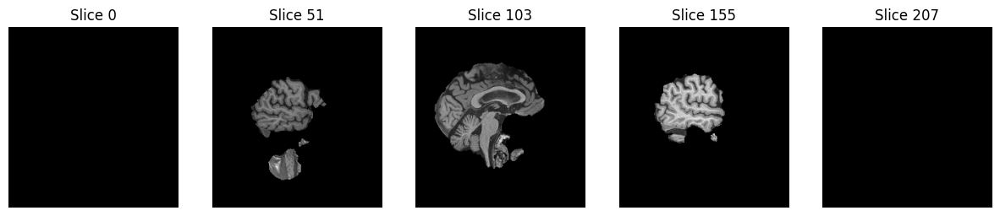

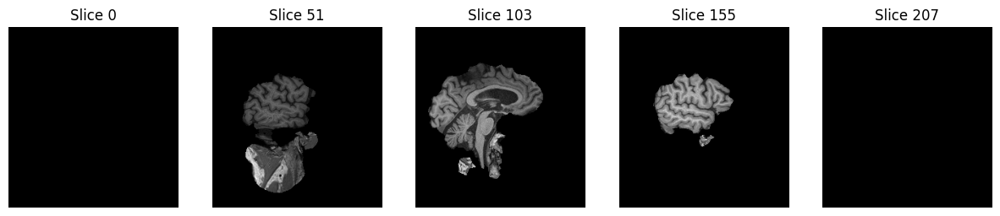

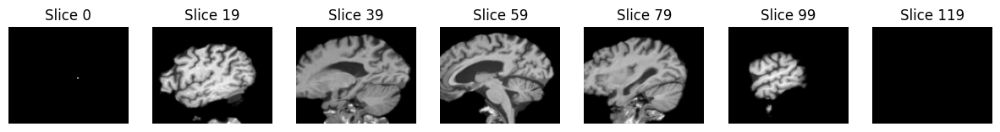

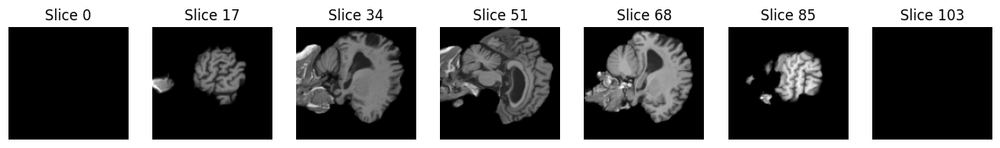

In [313]:
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\208\1_sub-ADNI002S0413_ses-M162_T1w.nii.gz", count=5, axis=0, transpose=True) #Template
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc7\3_sub-ADNI002S1261_ses-M132_T1w_brain.nii.gz", count=5, axis=0, transpose=True)
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc7\3_sub-ADNI002S1261_ses-M132_T1w_brain_restore.nii.gz", count=5, axis=0, transpose=True)
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc7\4_sub-ADNI002S1261_ses-M144_T1w_brain.nii.gz", count=5, axis=0, transpose=True)

plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc7\3_sub-ADNI002S1261_ses-M132_T1w_resampled.nii.gz", count=7, axis=1, transpose=False)
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc7\4_sub-ADNI002S1261_ses-M144_T1w_resampled.nii.gz", count=7, axis=0, transpose=False)

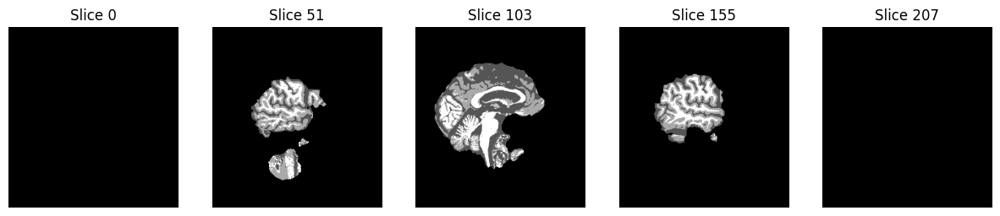

In [314]:

plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc7\3_sub-ADNI002S1261_ses-M132_T1w_brain_seg.nii.gz", count=5, axis=0, transpose=True)


#### HOLY SHIT I KNOEWWWW WHAT IS WRONGG!! OUR TEMPLATE IS THE FUCKING ORIGINAL IMAGE BRUUUUH, 

### APPLY PREPROCESSING TO THE TEMPLATE IMAGE, THEN USE THE PREPROCESSED_TEMPLATE AS TEMPLATE FOR SPATIAL NORMALIZATION; OMFG

I AM COOKED BRO

In [311]:
# C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc7\4_sub-ADNI002S1261_ses-M144_T1w_brain.nii.gz
# FROM THE PLOT ABOVE THIS WAS A REALLY GOOD TEMPLATE (FOR WHEN THE SKULL WAS REMOVED ALREADY, I SOUND POLISH NOW)

#!/bin/bash

# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/pre_proc7"
TEMPLATE="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/pre_proc7/3_sub-ADNI002S1261_ses-M132_T1w_brain.nii.gz"  # MNI template path
mkdir -p "$OUTPUT_DIR" # Create output directory if it doesn't exist

# DONT FUCKING PROCESS THE TEMPLATE BRO, PERHAPS THAT HELPS? NO bro, you send in the processed brain as template to curve fit the bitch 
FILES_TO_PROCESS=("3_sub-ADNI002S1261_ses-M132_T1w.nii.gz" "4_sub-ADNI002S1261_ses-M144_T1w.nii.gz")

for FILE in "${FILES_TO_PROCESS[@]}"; do
    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    
    # Full input file path
    FILE_PATH="$INPUT_DIR/$FILE"

    # 1. Skull stripping using BET
    bet "$FILE_PATH" "$OUTPUT_DIR/${BASENAME}_brain" -f 0.5 -g 0 -m
    
    # 2. Bias field correction using FAST
    fast -B "$OUTPUT_DIR/${BASENAME}_brain.nii.gz"
    
    # 3. Spatial normalization using FLIRT
    flirt -in "$OUTPUT_DIR/${BASENAME}_brain_restore.nii.gz" \
          -ref "$TEMPLATE" \
          -out "$OUTPUT_DIR/${BASENAME}_norm" \
          -omat "$OUTPUT_DIR/${BASENAME}_norm.mat"
    
    # 4. Resampling to isotropic 2mm voxel size
    fslmaths "$OUTPUT_DIR/${BASENAME}_norm.nii.gz" \
             -subsamp2 "$OUTPUT_DIR/${BASENAME}_resampled"
    
    echo "Finished processing: $BASENAME"
done

echo "Selected images processed. Results are in: $OUTPUT_DIR"


In [331]:
#plot_by_path(
path1 = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\176\0_sub-ADNI002S0413_ses-M132_T1w.nii.gz"
path2 = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\208\1_sub-ADNI002S0413_ses-M162_T1w.nii.gz"
img1 = nib.load(path1)  # Load the NIfTI file
img2 = nib.load(path2)  # Load the NIfTI file
img_data1 = img1.get_fdata()  # Get the image data as a NumPy array
img_data2 = img2.get_fdata()  # Get the image data as a NumPy array

print(img1.header.get_zooms())
print(img2.header.get_zooms())
print(img_data1.shape)
print(img_data2.shape)

#plt.imshow(img_data1.shape[0], axis=1)


(1.1999999, 1.0546875, 1.0546875)
(1.0, 1.0, 1.0)
(176, 240, 256)
(208, 240, 256)


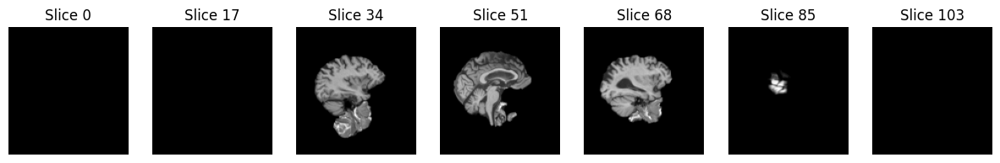

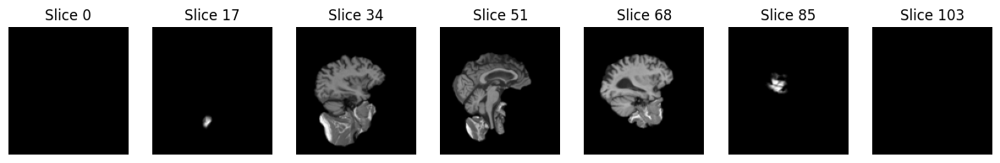

In [336]:
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc7\3_sub-ADNI002S1261_ses-M132_T1w_resampled.nii.gz", count=7, axis=0, transpose=True)
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\pre_proc7\4_sub-ADNI002S1261_ses-M144_T1w_resampled.nii.gz", count=7, axis=0, transpose=True)

In [ ]:
#!/bin/bash

# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"       # Directory with your .nii.gz files
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208"   # Directory to save preprocessed images

# TEMPLATE="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/176/0_sub-ADNI002S0413_ses-M132_T1w.nii.gz"  # MNI template path (preprocessed template)
# Create output directory if it doesn't exist
mkdir -p "$OUTPUT_DIR"

# Loop over all .nii.gz files in the input directory
for FILE in "$INPUT_DIR"/*.nii.gz; do
    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    
    # 1. Calculate the mean intensity using fslstats
    MEAN_INTENSITY=$(fslstats "$FILE" -M)
    
    # 2. Dynamically adjust -f parameter based on mean intensity
    if (( $(echo "$MEAN_INTENSITY < 100" | bc -l) )); then
        F_PARAM=0.6
    elif (( $(echo "$MEAN_INTENSITY < 110" | bc -l) )); then
        F_PARAM=0.65
    else
        F_PARAM=0.5
    fi
    
    # 3. Skull stripping using BET with dynamic -f value
    bet "$FILE" "$OUTPUT_DIR/${BASENAME}_brain" -f "$F_PARAM" -g 0 -m
    
    echo "Finished processing: $BASENAME"
done

echo "All images processed. Results are in: $OUTPUT_DIR"



# Make the script executable:
# chmod +x preprocess_mri.sh

# Run the script
# ./preprocess_mri.sh 

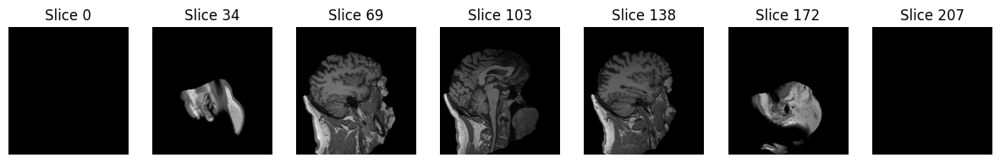

In [338]:
plot_by_path(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208\100_sub-ADNI007S6120_ses-M000_T1w_brain.nii.gz", count=7, axis=0, transpose=True)

In [2]:
import os
import nibabel as nib
import matplotlib.pyplot as plt
import math

# Define the folder containing the NIfTI files
folder_path = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208"

# Function to plot the middle slices of images between n1 and n2 in a single figure
def plot_middle_slices_in_range(folder_path, n1, n2, axis=1):
    # Get a sorted list of all files in the directory excluding mask files
    all_files = sorted(
        [f for f in os.listdir(folder_path) if f.endswith('.nii.gz') and not f.endswith('_mask.nii.gz')]
    )
    
    # Filter files between n1 and n2
    selected_files = all_files[n1:n2]
    num_images = len(selected_files)
    
    # Determine grid size for the plot
    cols = math.ceil(math.sqrt(num_images))  # Number of columns in the grid
    rows = math.ceil(num_images / cols)  # Number of rows in the grid
    
    # Create a figure for plotting
    fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
    axes = axes.flatten()  # Flatten to easily iterate over axes
    
    for i, file in enumerate(selected_files):
        file_path = os.path.join(folder_path, file)
        
        # Load the NIfTI file
        img = nib.load(file_path)
        img_data = img.get_fdata()
        
        # Calculate the middle index along axis 0
        middle_index = img_data.shape[axis] // 2
        
        # Plot the middle slice on the current axis
        axes[i].imshow(img_data[middle_index, :, :].T, cmap='gray', origin="lower")
        axes[i].set_title(file_path.split("\\")[-1].split("_")[0], fontsize=8)
        axes[i].axis('off')
    
    # Hide unused axes if the grid is larger than the number of images
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')
    
    plt.tight_layout()
    plt.show()

# Call the function with your desired range (e.g., 5 to 15)
#plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208", 0, 100, axis=1)


In [356]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208", 100, 200, axis=1)

plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\208", 100, 200, axis=1)


MEAN_INTENSITY=$(fslstats "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/1_sub-ADNI002S0413_ses-M162_T1w.nii.gz" -M)

fslstats "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/1_sub-ADNI002S0413_ses-M162_T1w.nii.gz" -M
fslstats "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/3_sub-ADNI002S1261_ses-M132_T1w.nii.gz" -M
fslstats "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/4_sub-ADNI002S1261_ses-M144_T1w.nii.gz" -M
fslstats "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/7_sub-ADNI002S4213_ses-M072_T1w.nii.gz" -M
fslstats "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/8_sub-ADNI002S4213_ses-M096_T1w.nii.gz" -M



SyntaxError: invalid syntax (3943894650.py, line 6)

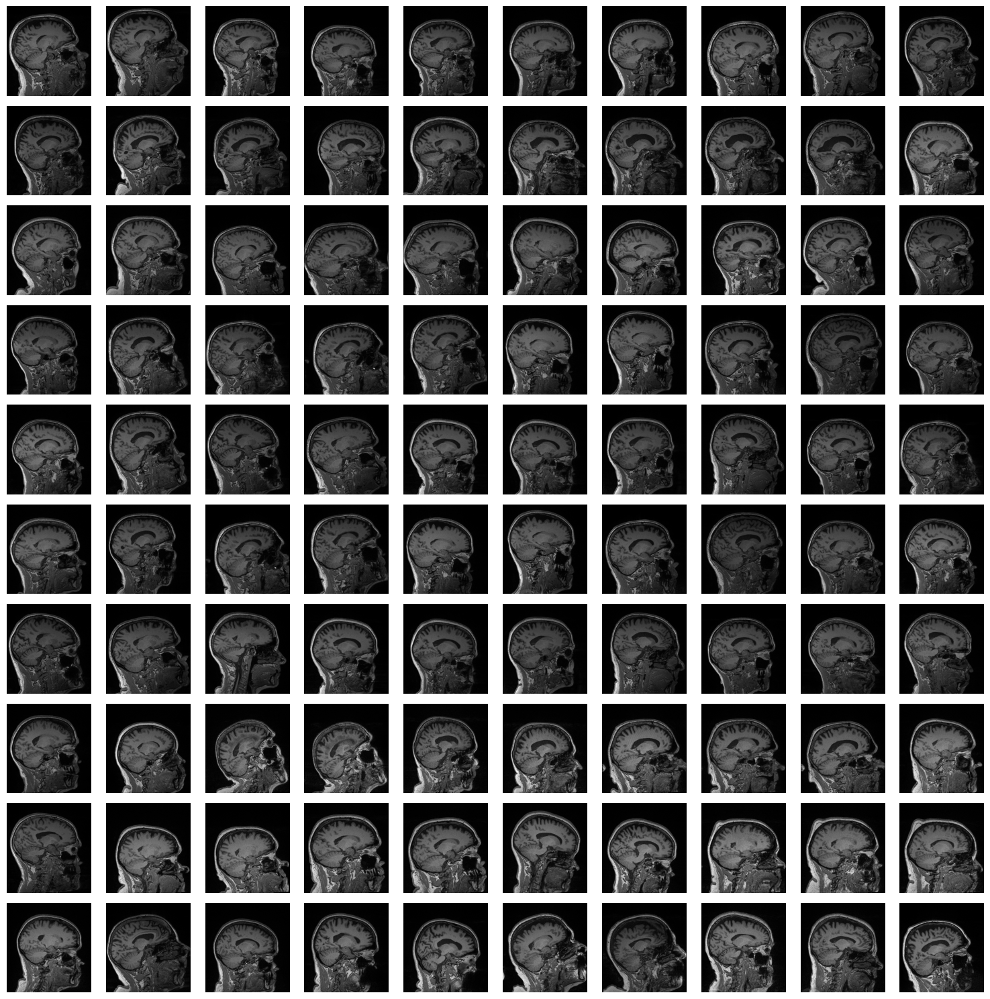

In [354]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\208", 000, 100, axis=1)

In [367]:
# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"       # Directory with your .nii.gz files
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_2"   # Directory to save preprocessed images

# Create output directory if it doesn't exist
mkdir -p "$OUTPUT_DIR"

# Initialize counter for processed images
COUNTER=0

# Loop over all .nii.gz files in the input directory
for FILE in "$INPUT_DIR"/*.nii.gz; do
    # Stop after the first 9 images
    if [ "$COUNTER" -ge 9 ]; then
        break
    fi

    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    
    # 1. Calculate the mean intensity using fslstats
    MEAN_INTENSITY=$(fslstats "$FILE" -M)
    
    # 2. Dynamically adjust -f parameter based on mean intensity
    if (( $(echo "$MEAN_INTENSITY < 100" | bc -l) )); then
        F_PARAM=0.5
    elif (( $(echo "$MEAN_INTENSITY < 110" | bc -l) )); then
        F_PARAM=0.5
    else
        F_PARAM=0.5
    fi
    
    # 3. Skull stripping using BET with dynamic -f value
    bet "$FILE" "$OUTPUT_DIR/${BASENAME}_brain" -f "$F_PARAM" -g 0 -m
    
    echo "Finished processing: $BASENAME"
    
    # Increment the counter
    COUNTER=$((COUNTER + 1))
done

echo "All images processed. Results are in: $OUTPUT_DIR"


SyntaxError: invalid syntax (4273146061.py, line 6)

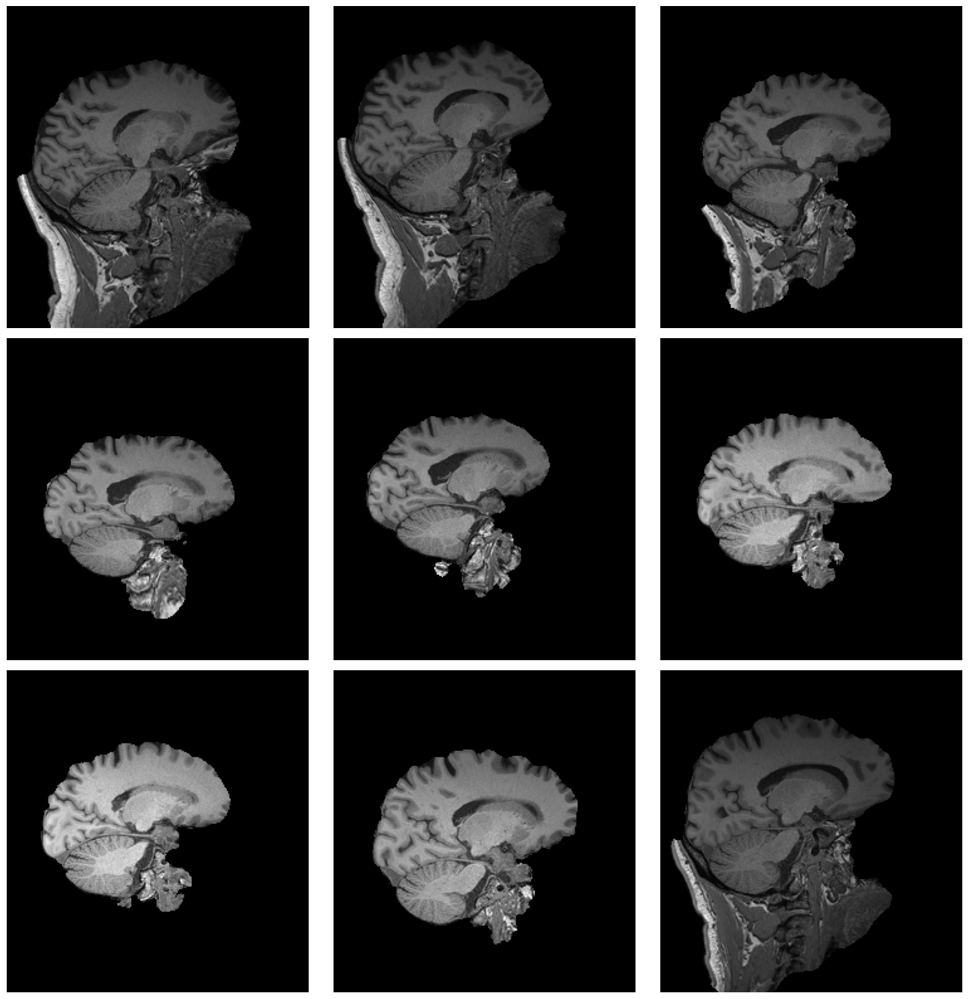

In [368]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208_2", 0, 10, axis=1)


In [ ]:
# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"       # Directory with your .nii.gz files
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_2"   # Directory to save preprocessed images

# Create output directory if it doesn't exist
mkdir -p "$OUTPUT_DIR"

# Initialize counter for processed images
COUNTER=0

# Loop over all .nii.gz files in the input directory
for FILE in "$INPUT_DIR"/*.nii.gz; do
    # Stop after the first 9 images
    if [ "$COUNTER" -ge 9 ]; then
        break
    fi

    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    
    # 1. Calculate the mean intensity using fslstats
    MEAN_INTENSITY=$(fslstats "$FILE" -M)
    
    # 2. Dynamically adjust -f parameter based on mean intensity
    if (( $(echo "$MEAN_INTENSITY < 100" | bc -l) )); then
        F_PARAM=0.7
    elif (( $(echo "$MEAN_INTENSITY < 110" | bc -l) )); then
        F_PARAM=0.7
    else
        F_PARAM=0.7
    fi
    
    # 3. Skull stripping using BET with dynamic -f value
    bet "$FILE" "$OUTPUT_DIR/${BASENAME}_brain" -f "$F_PARAM" -g 0 -m
    
    echo "Finished processing: $BASENAME"
    
    # Increment the counter
    COUNTER=$((COUNTER + 1))
done

echo "All images processed. Results are in: $OUTPUT_DIR"


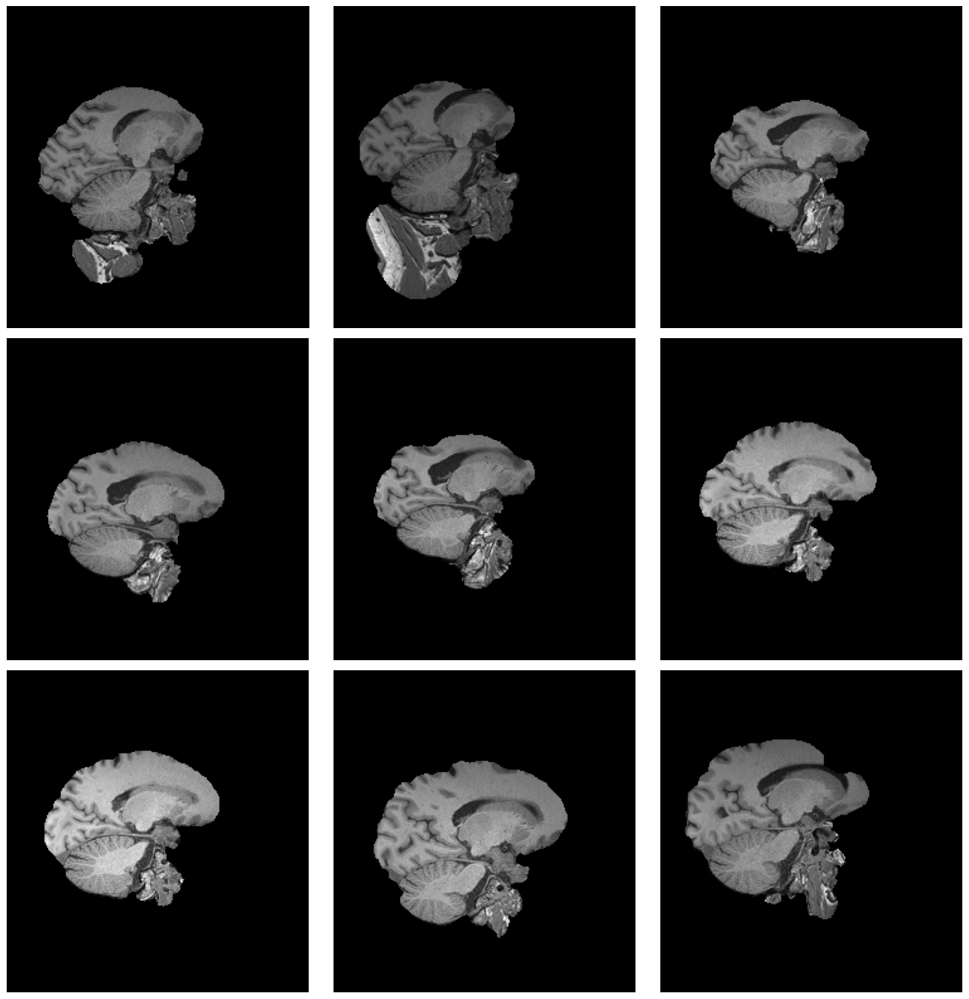

In [369]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208_2", 0, 10, axis=1)


In [ ]:

fslstats "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/100_sub-ADNI007S6120_ses-M000_T1w.nii.gz" -M
fslstats "/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/103_sub-ADNI007S6255_ses-M012_T1w.nii.gz" -M

In [ ]:
# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"       # Directory with your .nii.gz files
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_2"   # Directory to save preprocessed images

# Create output directory if it doesn't exist
mkdir -p "$OUTPUT_DIR"

# Initialize counter for processed images
COUNTER=0

# Loop over all .nii.gz files in the input directory
for FILE in "$INPUT_DIR"/*.nii.gz; do
    # Stop after the first 9 images
    if [ "$COUNTER" -ge 9 ]; then
        break
    fi

    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    
    # 1. Calculate the mean intensity using fslstats
    MEAN_INTENSITY=$(fslstats "$FILE" -M)
    
    # 2. Dynamically adjust -f parameter based on mean intensity
    if (( $(echo "$MEAN_INTENSITY < 100" | bc -l) )); then
        F_PARAM=0.5  # Lower value to be more aggressive
    elif (( $(echo "$MEAN_INTENSITY < 110" | bc -l) )); then
        F_PARAM=0.5
    else
        F_PARAM=0.5
    fi

    # 3. Dynamically adjust -g parameter for more aggressive cutting of the neck
    #if (( $(echo "$MEAN_INTENSITY < 100" | bc -l) )); then
    #    G_PARAM=0.3  # Larger positive value to shift the brain outline down
    #else
    #    G_PARAM=0.4  # Slightly higher for more aggressive cutting of lower areas
    #fi
    F_PARAM=0.5
    G_PARAM=-0.5

    # 4. Skull stripping using BET with dynamic -f and -g values
    bet "$FILE" "$OUTPUT_DIR/${BASENAME}_brain" -f "$F_PARAM" -g "$G_PARAM" -m
    
    echo "Finished processing: $BASENAME"
    
    # Increment the counter
    COUNTER=$((COUNTER + 1))
done

echo "All images processed. Results are in: $OUTPUT_DIR"


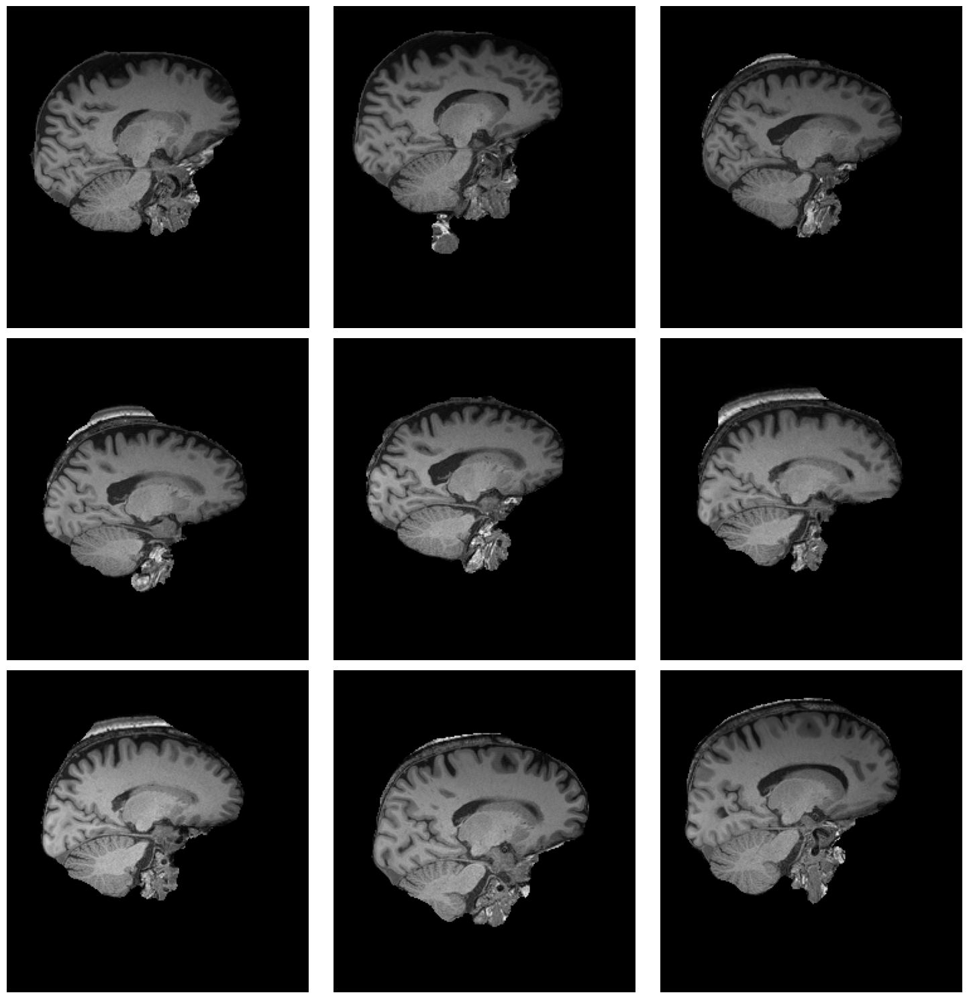

In [380]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208_2", 0, 10, axis=1)


In [ ]:
# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"       # Directory with your .nii.gz files
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_2"   # Directory to save preprocessed images

# Create output directory if it doesn't exist
mkdir -p "$OUTPUT_DIR"

# Initialize counter for processed images
COUNTER=0

# Loop over all .nii.gz files in the input directory
for FILE in "$INPUT_DIR"/*.nii.gz; do
    # Stop after the first 9 images
    if [ "$COUNTER" -ge 9 ]; then
        break
    fi

    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    
    # 1. Calculate the mean intensity using fslstats
    MEAN_INTENSITY=$(fslstats "$FILE" -M)
    
    # 2. Dynamically adjust -f parameter based on mean intensity
    #if (( $(echo "$MEAN_INTENSITY < 100" | bc -l) )); then
    #    F_PARAM=0.5  # Lower value to be more aggressive
    #elif (( $(echo "$MEAN_INTENSITY < 110" | bc -l) )); then
    #    F_PARAM=0.5
    #else
    #    F_PARAM=0.5
    #fi

    G_PARAM=-0.3
    F_PARAM=0.5
    # 3. Dynamically adjust -g parameter for more aggressive cutting of the neck
    if (( $(echo "$MEAN_INTENSITY < 100" | bc -l) )); then
        G_PARAM=-0.4
        F_PARAM=0.8

    elif (( $(echo "$MEAN_INTENSITY < 110" | bc -l) )); then
        G_PARAM=-0.5
        F_PARAM=0.8
    else
        G_PARAM=-0.6
        F_PARAM=0.8
    fi
    #F_PARAM=0.5
    #G_PARAM=-0.5

    # 4. Skull stripping using BET with dynamic -f and -g values
    bet "$FILE" "$OUTPUT_DIR/${BASENAME}_brain" -f "$F_PARAM" -g "$G_PARAM" -m
    
    echo "Finished processing: $BASENAME"
    
    # Increment the counter
    COUNTER=$((COUNTER + 1))
done

echo "All images processed. Results are in: $OUTPUT_DIR"


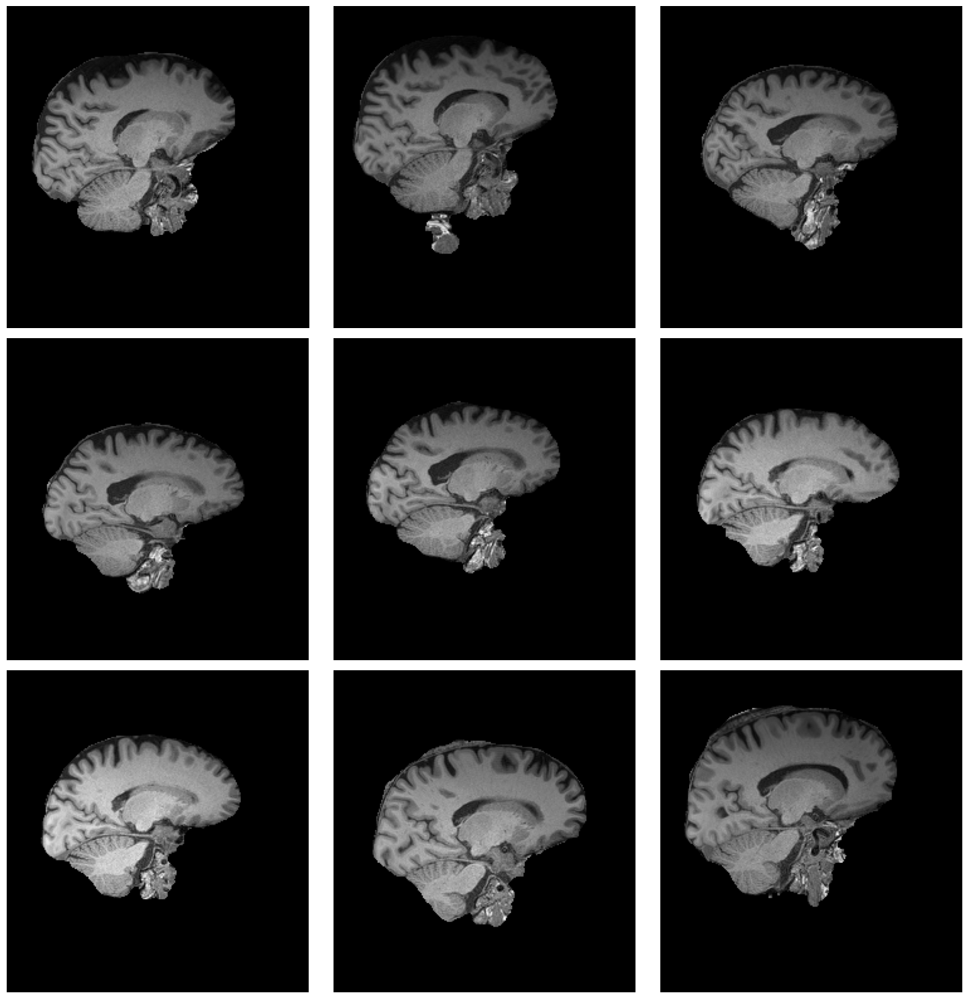

In [403]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208_2", 0, 10, axis=1)


In [ ]:
# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"       # Directory with your .nii.gz files
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_2"   # Directory to save preprocessed images

# Create output directory if it doesn't exist
mkdir -p "$OUTPUT_DIR"

# Initialize counter for processed images
COUNTER=0

# Loop over all .nii.gz files in the input directory
for FILE in "$INPUT_DIR"/*.nii.gz; do
    # Stop after the first 9 images
    if [ "$COUNTER" -ge 9 ]; then
        break
    fi

    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    
    # 1. Calculate the mean intensity using fslstats
    MEAN_INTENSITY=$(fslstats "$FILE" -M)
    
    # 2. Dynamically adjust -f parameter based on mean intensity
    #if (( $(echo "$MEAN_INTENSITY < 100" | bc -l) )); then
    #    F_PARAM=0.5  # Lower value to be more aggressive
    #elif (( $(echo "$MEAN_INTENSITY < 110" | bc -l) )); then
    #    F_PARAM=0.5
    #else
    #    F_PARAM=0.5
    #fi

    G_PARAM=-0.3
    F_PARAM=0.5
    # 3. Dynamically adjust -g parameter for more aggressive cutting of the neck
    if (( $(echo "$MEAN_INTENSITY < 100" | bc -l) )); then
        G_PARAM=-0.3
        F_PARAM=0.45

    elif (( $(echo "$MEAN_INTENSITY < 110" | bc -l) )); then
        G_PARAM=-0.3
        F_PARAM=0.55
    else
        G_PARAM=-0.3
        F_PARAM=0.65
    fi
    #F_PARAM=0.5
    #G_PARAM=-0.5

    # 4. Skull stripping using BET with dynamic -f and -g values
    bet "$FILE" "$OUTPUT_DIR/${BASENAME}_brain" -f "$F_PARAM" -g "$G_PARAM" -m
    
    echo "Finished processing: $BASENAME"
    
    # Increment the counter
    COUNTER=$((COUNTER + 1))
done

echo "All images processed. Results are in: $OUTPUT_DIR"


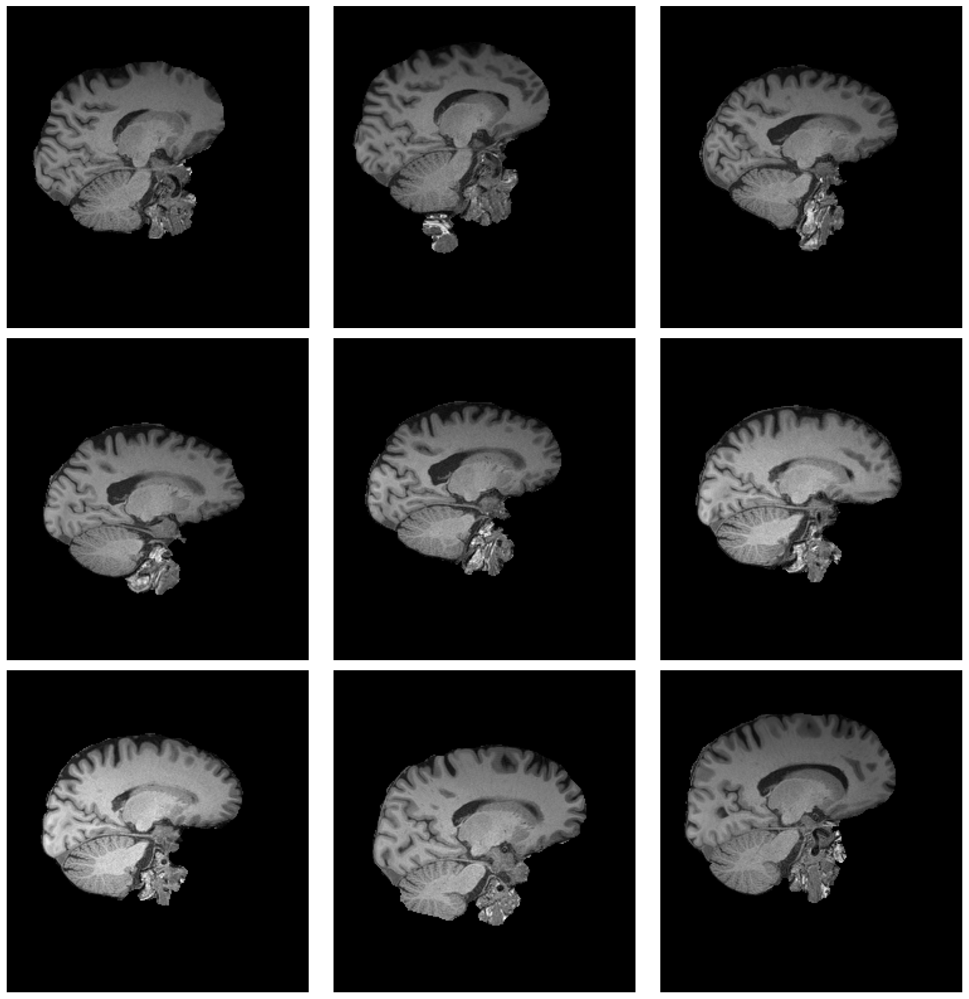

In [408]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208_2", 0, 10, axis=1)


In [ ]:
# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"       # Directory with your .nii.gz files
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_2"   # Directory to save preprocessed images

# Create output directory if it doesn't exist
mkdir -p "$OUTPUT_DIR"

# Initialize counter for processed images
COUNTER=0

# Loop over all .nii.gz files in the input directory
for FILE in "$INPUT_DIR"/*.nii.gz; do
    # Stop after the first 9 images
    #if [ "$COUNTER" -ge 9 ]; then
    #    break
    #fi

    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    
    # 1. Calculate the mean intensity using fslstats
    MEAN_INTENSITY=$(fslstats "$FILE" -M)

    G_PARAM=-0.3
    F_PARAM=0.5
    # 3. Dynamically adjust -g/-f parameter for more aggressive cutting of the neck
    if (( $(echo "$MEAN_INTENSITY < 100" | bc -l) )); then
        G_PARAM=-0.3
        F_PARAM=0.45

    elif (( $(echo "$MEAN_INTENSITY < 110" | bc -l) )); then
        G_PARAM=-0.3
        F_PARAM=0.55
    else
        G_PARAM=-0.3
        F_PARAM=0.65
    fi

    # 4. Skull stripping using BET with dynamic -f and -g values
    bet "$FILE" "$OUTPUT_DIR/${BASENAME}_brain" -f "$F_PARAM" -g "$G_PARAM" -m
    
    echo "Finished processing: $BASENAME"
    
    # Increment the counter
    COUNTER=$((COUNTER + 1))
done

echo "All images processed. Results are in: $OUTPUT_DIR"


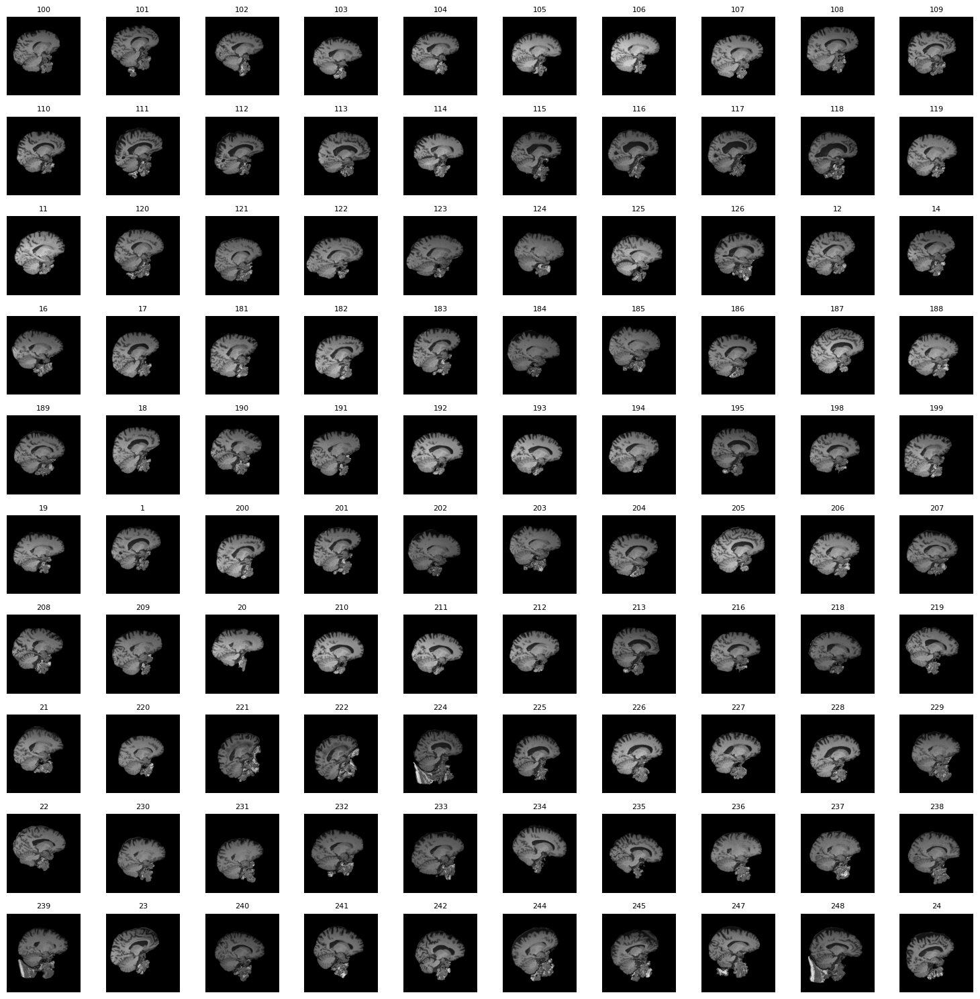

In [45]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208_2", 000, 100, axis=1)

### THE PREPROCESSSING WORKS WELL, BUT I'D LIKE TO MAKE IT BETTER:
- Pick a small (9) representative sample of the population with the highest variance between them and optimize the function for these. (20seconds waiting time to process 9 images so doing it on a small sample like this should help for the final cut)
- Write down all outlier numbers manually and simply filter those out. (estimated time 5minutes)

In [114]:
folder_path = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208_2"
n1 = 0
n2 = 900

all_files = sorted(
    [f for f in os.listdir(folder_path) if f.endswith('.nii.gz') and not f.endswith('_mask.nii.gz')]
)

# Filter files between n1 and n2
#selected_files = all_files[n1:n2]
#num_images = len(selected_files)
#selected_files

my_fav_numbers = [100,101,105,184,224,248,247,352,120]
small_sample_files = [f for f in all_files if int(f.split("\\")[-1].split("_")[0]) in my_fav_numbers]

In [4]:
import os
import nibabel as nib
import matplotlib.pyplot as plt
import math

# Define the folder containing the NIfTI files
folder_path = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208_2"

# Function to plot the middle slices of images between n1 and n2 in a single figure
def plot_middle_slices_in_range_small_sample(all_file_paths, n1, n2, axis=1):
    # Get a sorted list of all files in the directory excluding mask files
    all_files = all_file_paths
    
    # Filter files between n1 and n2
    selected_files = all_files[n1:n2]
    num_images = len(selected_files)
    
    # Determine grid size for the plot
    cols = math.ceil(math.sqrt(num_images))  # Number of columns in the grid
    rows = math.ceil(num_images / cols)  # Number of rows in the grid
    
    # Create a figure for plotting
    fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
    axes = axes.flatten()  # Flatten to easily iterate over axes
    
    for i, file in enumerate(selected_files):
        file_path = os.path.join(folder_path, file)
        
        # Load the NIfTI file
        img = nib.load(file_path)
        img_data = img.get_fdata()
        
        # Calculate the middle index along axis 0
        middle_index = img_data.shape[axis] // 2
        
        # Plot the middle slice on the current axis
        axes[i].imshow(img_data[middle_index, :, :].T, cmap='gray', origin="lower")
        axes[i].set_title(file_path.split("\\")[-1].split("_")[0], fontsize=8)
        axes[i].axis('off')
    
    # Hide unused axes if the grid is larger than the number of images
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')
    
    plt.tight_layout()
    plt.show()

# Call the function with your desired range (e.g., 5 to 15)

plot_middle_slices_in_range_small_sample(small_sample_files, 0, 9, axis=1)

NameError: name 'small_sample_files' is not defined

In [120]:
#folder_path = "C:/Users/kiran/Documents7_UIS/sem6/BACH/Data/208"

local_paths = [f.replace("_brain", "") for f in small_sample_files]

In [37]:
# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"       # Directory with your .nii.gz files
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_3"   # Directory to save preprocessed images

# Create output directory if it doesn't exist
mkdir -p "$OUTPUT_DIR"

# Initialize counter for processed images
COUNTER=0

# List of specific files to preprocess
FILES_TO_PROCESS=(
    "100_sub-ADNI007S6120_ses-M000_T1w.nii.gz"
    "101_sub-ADNI007S6120_ses-M012_T1w.nii.gz"
    "105_sub-ADNI007S6310_ses-M000_T1w.nii.gz"
    "184_sub-ADNI020S6227_ses-M000_T1w.nii.gz"
    "224_sub-ADNI023S1190_ses-M144_T1w.nii.gz"
    "247_sub-ADNI024S6005_ses-M024_T1w.nii.gz"
    "248_sub-ADNI024S6005_ses-M054_T1w.nii.gz"
    "352_sub-ADNI035S0156_ses-M150_T1w.nii.gz"
    "120_sub-ADNI011S6367_ses-M012_T1w.nii.gz"
)

# Loop over the files to process
for BASENAME in "${FILES_TO_PROCESS[@]}"; do
    FILE="$INPUT_DIR/$BASENAME"

    # Check if the file exists before processing
    if [ -f "$FILE" ]; then
        echo "Processing: $BASENAME"

        # 1. Calculate the mean intensity using fslstats
        MEAN_INTENSITY=$(fslstats "$FILE" -M)

        # Set default -g and -f parameters
        G_PARAM=-0.3
        F_PARAM=0.5

        # 3. Dynamically adjust -g/-f parameter for more aggressive cutting of the neck
        if (( $(echo "$MEAN_INTENSITY < 90" | bc -l) )); then
            G_PARAM=-0.6
            F_PARAM=0.8
        elif (( $(echo "$MEAN_INTENSITY < 100" | bc -l) )); then
            G_PARAM=-0.4
            F_PARAM=0.45
        elif (( $(echo "$MEAN_INTENSITY < 110" | bc -l) )); then
            G_PARAM=-0.45
            F_PARAM=0.55
        elif (( $(echo "$MEAN_INTENSITY < 150" | bc -l) )); then
            G_PARAM=-0.42
            F_PARAM=0.56
        else
            G_PARAM=-0.5
            F_PARAM=0.65
        fi

        #G_PARAM=-1
        #F_PARAM=0.5

        # 4. Skull stripping using BET with dynamic -f and -g values
        bet "$FILE" "$OUTPUT_DIR/${BASENAME%.nii.gz}_brain" -f "$F_PARAM" -g "$G_PARAM" -m

        echo "Finished processing: $BASENAME"

        # Increment the counter
        COUNTER=$((COUNTER + 1))
    else
        echo "File not found: $BASENAME"
    fi

done

echo "All specified images processed. Results are in: $OUTPUT_DIR"

1_sub-ADNI002S0413_ses-M162_T1w.nii.gz


In [121]:
#fslstats "$FILE" -M
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"
local_paths
cmd = ["fslstats '"+ INPUT_DIR + "/" +f+"'" + " -M" for f in local_paths]
for c in cmd: print(c)

fslstats '/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/100_sub-ADNI007S6120_ses-M000_T1w.nii.gz' -M
fslstats '/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/101_sub-ADNI007S6120_ses-M012_T1w.nii.gz' -M
fslstats '/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/105_sub-ADNI007S6310_ses-M000_T1w.nii.gz' -M
fslstats '/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/120_sub-ADNI011S6367_ses-M012_T1w.nii.gz' -M
fslstats '/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/184_sub-ADNI020S6227_ses-M000_T1w.nii.gz' -M
fslstats '/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/224_sub-ADNI023S1190_ses-M144_T1w.nii.gz' -M
fslstats '/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/247_sub-ADNI024S6005_ses-M024_T1w.nii.gz' -M
fslstats '/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/248_sub-ADNI024S6005_ses-M054_T1w.nii.gz' -M
fslstats '/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/352_sub-ADNI035S0156_ses-M150_T1w.nii.gz' -M


In [66]:
intensities = [151.682768,181.829311,87.735624,148.174431, 92.653609,78.816612,101.017366,84.636351,87.230598]

In [75]:
"""
# Function to plot the middle slices of images between n1 and n2 in a single figure
def plot_middle_slices_in_range_wintensities(folder_path, intensities, n1, n2, axis=1):
    # Get a sorted list of all files in the directory excluding mask files
    all_files = sorted(
        [f for f in os.listdir(folder_path) if f.endswith('.nii.gz') and not f.endswith('_mask.nii.gz')]
    )
    
    # Filter files between n1 and n2
    selected_files = all_files[n1:n2]
    num_images = len(selected_files)
    
    # Determine grid size for the plot
    cols = math.ceil(math.sqrt(num_images))  # Number of columns in the grid
    rows = math.ceil(num_images / cols)  # Number of rows in the grid
    
    # Create a figure for plotting
    fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
    axes = axes.flatten()  # Flatten to easily iterate over axes
    
    for i, file in enumerate(selected_files):
        file_path = os.path.join(folder_path, file)
        
        # Load the NIfTI file
        img = nib.load(file_path)
        img_data = img.get_fdata()
        
        # Calculate the middle index along axis 0
        middle_index = img_data.shape[axis] // 2
        
        # Plot the middle slice on the current axis
        axes[i].imshow(img_data[middle_index, :, :].T, cmap='gray', origin="lower")
        axes[i].set_title(file_path.split("\\")[-1].split("_")[0] +"|"+ str(intensities[i]), fontsize=8)
        axes[i].axis('off')
    
    # Hide unused axes if the grid is larger than the number of images
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')
    
    plt.tight_layout()
    plt.show()

plot_middle_slices_in_range_wintensities(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\208", intensities, 0, 100, axis=1)
"""


SyntaxError: (unicode error) 'unicodeescape' codec can't decode bytes in position 1683-1684: truncated \UXXXXXXXX escape (3398601526.py, line 44)

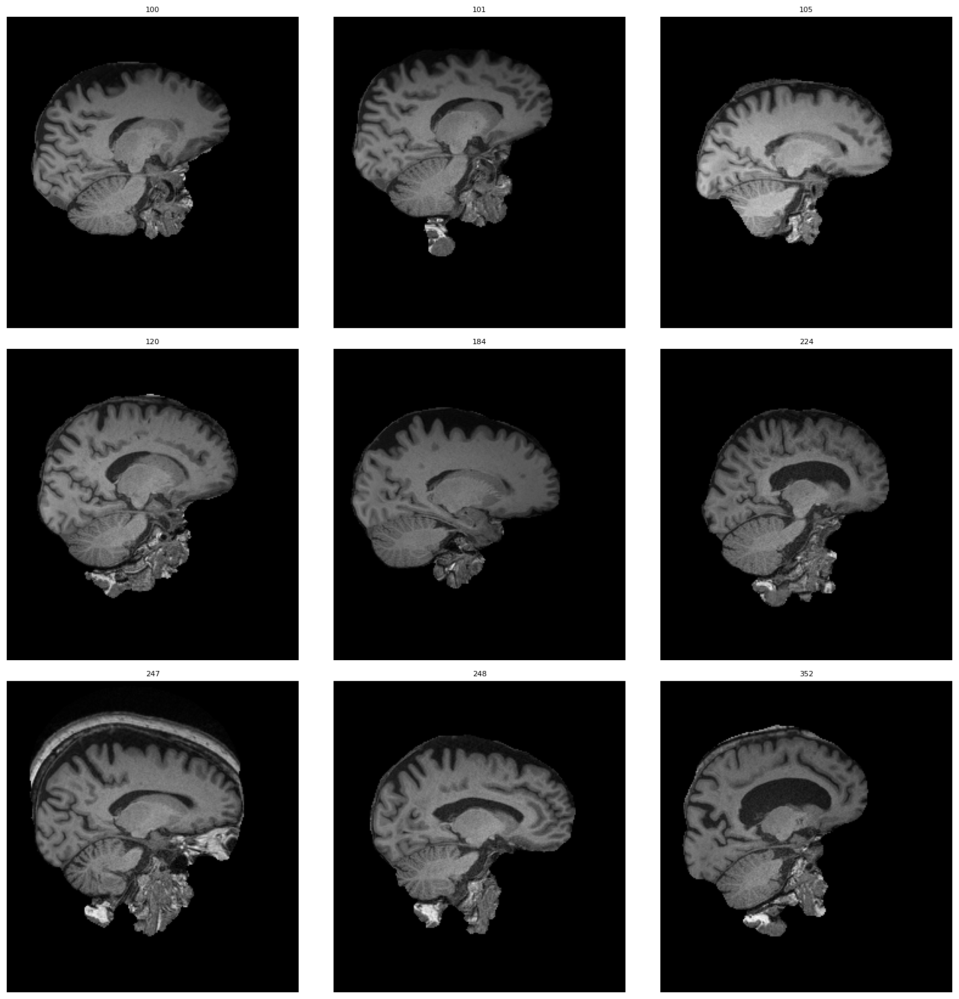

In [136]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208_3", 0, 9, axis=1)

In [117]:
# manually cutting one tricky image to save time:

img1:
/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/352_sub-ADNI035S0156_ses-M150_T1w.nii.gz
/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_3/352_sub-ADNI035S0156_ses-M150_T1w_brain.nii.gz

img2:
/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/248_sub-ADNI024S6005_ses-M054_T1w.nii.gz
/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_3/248_sub-ADNI024S6005_ses-M054_T1w_brain.nii.gz

im3:
/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/120_sub-ADNI011S6367_ses-M012_T1w.nii.gz
/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_3/120_sub-ADNI011S6367_ses-M012_T1w_brain.nii.gz

im4:
/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208/247_sub-ADNI024S6005_ses-M024_T1w.nii.gz
/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_3/247_sub-ADNI024S6005_ses-M024_T1w_brain.nii.gz


# AMAZING IT WORKS FINE NOW!!

SyntaxError: invalid decimal literal (2366592090.py, line 4)

In [ ]:
# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"       # Directory with your .nii.gz files
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_3"   # Directory to save preprocessed images

# Create output directory if it doesn't exist
mkdir -p "$OUTPUT_DIR"

# Initialize counter for processed images
COUNTER=0

# Loop over all .nii.gz files in the input directory
for FILE in "$INPUT_DIR"/*.nii.gz; do
    # Stop after the first 9 images
    #if [ "$COUNTER" -ge 9 ]; then
    #    break
    #fi

    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    
    # 1. Calculate the mean intensity using fslstats
    MEAN_INTENSITY=$(fslstats "$FILE" -M)

    G_PARAM=-0.3
    F_PARAM=0.5
    # 3. Dynamically adjust -g/-f parameter for more aggressive cutting of the neck
    if (( $(echo "$MEAN_INTENSITY < 90" | bc -l) )); then
        G_PARAM=-0.6
        F_PARAM=0.8
    elif (( $(echo "$MEAN_INTENSITY < 100" | bc -l) )); then
        G_PARAM=-0.4
        F_PARAM=0.45
    elif (( $(echo "$MEAN_INTENSITY < 110" | bc -l) )); then
        G_PARAM=-0.45
        F_PARAM=0.55
    elif (( $(echo "$MEAN_INTENSITY < 150" | bc -l) )); then
        G_PARAM=-0.48
        F_PARAM=0.6
    else
        G_PARAM=-0.5
        F_PARAM=0.65
    fi

    # G_PARAM=-0.3
    # F_PARAM=0.65

    # 4. Skull stripping using BET with dynamic -f and -g values
    bet "$FILE" "$OUTPUT_DIR/${BASENAME}_brain" -f "$F_PARAM" -g "$G_PARAM" -m
    
    echo "Finished processing: $BASENAME"
    
    # Increment the counter
    COUNTER=$((COUNTER + 1))
done

echo "All images processed. Results are in: $OUTPUT_DIR"


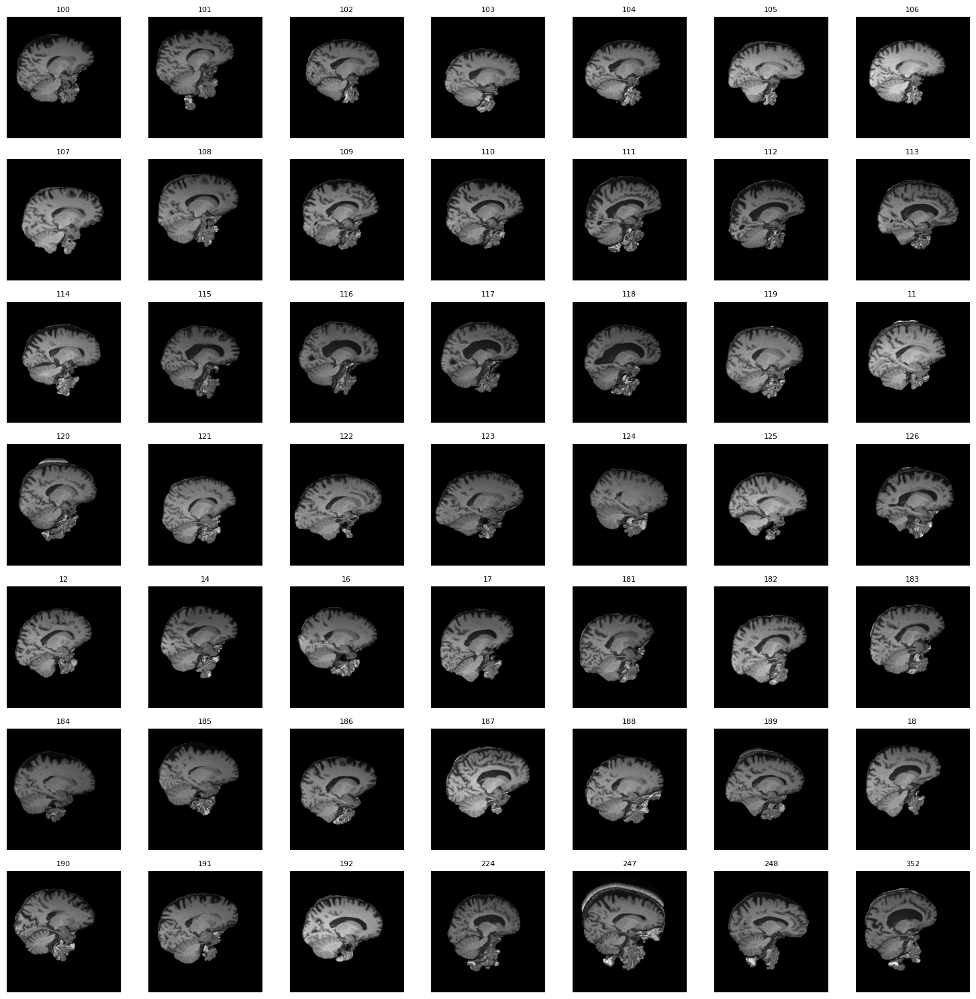

In [140]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208_3", 000, 100, axis=1)

# HOW ABOUT WE ONLY ADJUST THE PARAMETERS FOR THE BRAINS OF SPECIFIC INTENSITY AT A TIME?

In [141]:
#!/bin/bash

# Define the directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"
OUTPUT_FILE="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/DATA/intensities.csv"

# Check if the output file exists, and create it if not
if [ ! -f "$OUTPUT_FILE" ]; then
    # Add header if the file is empty
    echo "Filename,MeanIntensity" > "$OUTPUT_FILE"
fi

# Loop through each NIfTI file in the input directory
for FILE in "$INPUT_DIR"/*.nii.gz; do
    # Get the file name (without path)
    BASENAME=$(basename "$FILE")
    
    # Get the mean intensity using fslstats
    MEAN_INTENSITY=$(fslstats "$FILE" -M)
    
    # Append the file name and mean intensity to the CSV file
    echo "$BASENAME,$MEAN_INTENSITY" >> "$OUTPUT_FILE"
done

echo "Intensity values saved to $OUTPUT_FILE"


SyntaxError: invalid syntax (928589667.py, line 8)

In [2]:
import csv

def get_images_by_intensity(n, i1, i2):
    # List to hold the filenames
    images = []
    
    # Open the CSV file
    with open(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\intensities.csv", mode='r') as file:
        # Read the CSV file
        reader = csv.reader(file)
        
        # Skip header
        next(reader)
        
        # Iterate through each row and filter by intensity range
        for row in reader:
            filename, mean_intensity = row[0], float(row[1])
            
            # Check if the mean intensity is within the given range
            if i1 <= mean_intensity <= i2:
                images.append(filename)
            
            # Stop if we've reached the desired number of images
            if len(images) >= n:
                break

    return images

# Example usage
images = get_images_by_intensity(n=16, i1=0, i2=80)
print(images)


['126_sub-ADNI012S4643_ses-M066_T1w.nii.gz', '221_sub-ADNI023S0031_ses-M150_T1w.nii.gz', '222_sub-ADNI023S0031_ses-M162_T1w.nii.gz', '224_sub-ADNI023S1190_ses-M144_T1w.nii.gz', '225_sub-ADNI023S1190_ses-M156_T1w.nii.gz', '228_sub-ADNI023S4164_ses-M120_T1w.nii.gz', '229_sub-ADNI023S4448_ses-M072_T1w.nii.gz', '230_sub-ADNI023S4448_ses-M096_T1w.nii.gz', '231_sub-ADNI023S4448_ses-M120_T1w.nii.gz', '235_sub-ADNI023S6374_ses-M048_T1w.nii.gz', '240_sub-ADNI023S6400_ses-M048_T1w.nii.gz', '242_sub-ADNI023S6547_ses-M048_T1w.nii.gz', '24_sub-ADNI003S4119_ses-M096_T1w.nii.gz', '259_sub-ADNI032S0677_ses-M132_T1w.nii.gz', '25_sub-ADNI003S4119_ses-M120_T1w.nii.gz', '260_sub-ADNI032S0677_ses-M156_T1w.nii.gz']


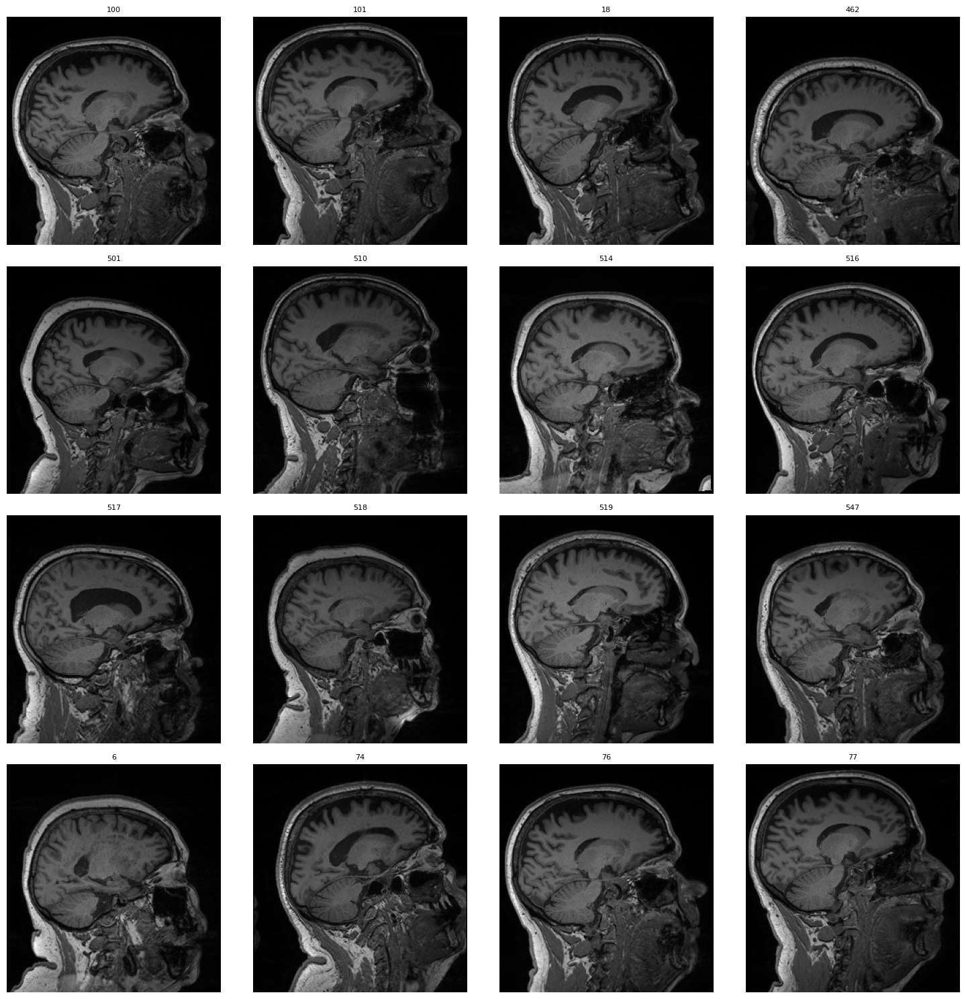

In [30]:
folder_path = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\208"

images = get_images_by_intensity(n=16, i1=150, i2=1000)

plot_middle_slices_in_range_small_sample(images, 0, 16, axis=1)

In [32]:
images = get_images_by_intensity(n=16, i1=150, i2=1000)
images

['100_sub-ADNI007S6120_ses-M000_T1w.nii.gz',
 '101_sub-ADNI007S6120_ses-M012_T1w.nii.gz',
 '18_sub-ADNI002S6053_ses-M024_T1w.nii.gz',
 '462_sub-ADNI037S6993_ses-M000_T1w.nii.gz',
 '501_sub-ADNI067S0056_ses-M144_T1w.nii.gz',
 '510_sub-ADNI067S6442_ses-M000_T1w.nii.gz',
 '514_sub-ADNI067S6518_ses-M000_T1w.nii.gz',
 '516_sub-ADNI067S6528_ses-M036_T1w.nii.gz',
 '517_sub-ADNI067S6957_ses-M000_T1w.nii.gz',
 '518_sub-ADNI067S6958_ses-M000_T1w.nii.gz',
 '519_sub-ADNI067S7059_ses-M000_T1w.nii.gz',
 '547_sub-ADNI073S6907_ses-M000_T1w.nii.gz',
 '6_sub-ADNI002S1280_ses-M144_T1w.nii.gz',
 '74_sub-ADNI007S4620_ses-M078_T1w.nii.gz',
 '76_sub-ADNI007S6120_ses-M000_T1w.nii.gz',
 '77_sub-ADNI007S6120_ses-M012_T1w.nii.gz']

In [ ]:
#!/bin/bash

# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"  # Directory with your .nii.gz files
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_3"  # Directory to save preprocessed images

# Create output directory if it doesn't exist
mkdir -p "$OUTPUT_DIR"

# List of specific files to preprocess
FILES_TO_PROCESS=(
    '100_sub-ADNI007S6120_ses-M000_T1w.nii.gz'
    '101_sub-ADNI007S6120_ses-M012_T1w.nii.gz'
    '18_sub-ADNI002S6053_ses-M024_T1w.nii.gz'
    '462_sub-ADNI037S6993_ses-M000_T1w.nii.gz'
    '501_sub-ADNI067S0056_ses-M144_T1w.nii.gz'
    '510_sub-ADNI067S6442_ses-M000_T1w.nii.gz'
    '514_sub-ADNI067S6518_ses-M000_T1w.nii.gz'
    '516_sub-ADNI067S6528_ses-M036_T1w.nii.gz'
    '517_sub-ADNI067S6957_ses-M000_T1w.nii.gz'
    '518_sub-ADNI067S6958_ses-M000_T1w.nii.gz'
    '519_sub-ADNI067S7059_ses-M000_T1w.nii.gz'
    '547_sub-ADNI073S6907_ses-M000_T1w.nii.gz'
    '6_sub-ADNI002S1280_ses-M144_T1w.nii.gz'
    '74_sub-ADNI007S4620_ses-M078_T1w.nii.gz'
    '76_sub-ADNI007S6120_ses-M000_T1w.nii.gz'
    '77_sub-ADNI007S6120_ses-M012_T1w.nii.gz'
)

# Function to process a single file
process_file() {
    BASENAME="$1"
    FILE="$INPUT_DIR/$BASENAME"
    
    if [ -f "$FILE" ]; then
        echo "Processing: $BASENAME"

        # Calculate mean intensity
        MEAN_INTENSITY=$(fslstats "$FILE" -M)

        # Set dynamic parameters
        if (( $(echo "$MEAN_INTENSITY < 80" | bc -l) )); then
            G_PARAM=-0.45
            F_PARAM=0.50
        elif (( $(echo "$MEAN_INTENSITY < 90" | bc -l) )); then
            G_PARAM=-0.35
            F_PARAM=0.5
        elif (( $(echo "$MEAN_INTENSITY < 100" | bc -l) )); then
            G_PARAM=-0.35
            F_PARAM=0.5
        elif (( $(echo "$MEAN_INTENSITY < 110" | bc -l) )); then
            G_PARAM=-0.35
            F_PARAM=0.5
        elif (( $(echo "$MEAN_INTENSITY < 150" | bc -l) )); then
            G_PARAM=-0.4
            F_PARAM=0.5
        else
            G_PARAM=-0.5
            F_PARAM=0.5
        fi

        # Skull stripping
        bet "$FILE" "$OUTPUT_DIR/${BASENAME%.nii.gz}_brain" -f "$F_PARAM" -g "$G_PARAM" -m
        echo "Finished processing: $BASENAME"
    else
        echo "File not found: $BASENAME"
    fi
}

export -f process_file
export INPUT_DIR OUTPUT_DIR  # Export variables for parallel

# Run in parallel
echo "Starting parallel processing..."
parallel --jobs "$(nproc)" process_file ::: "${FILES_TO_PROCESS[@]}"


echo "All specified images processed. Results are in: $OUTPUT_DIR"


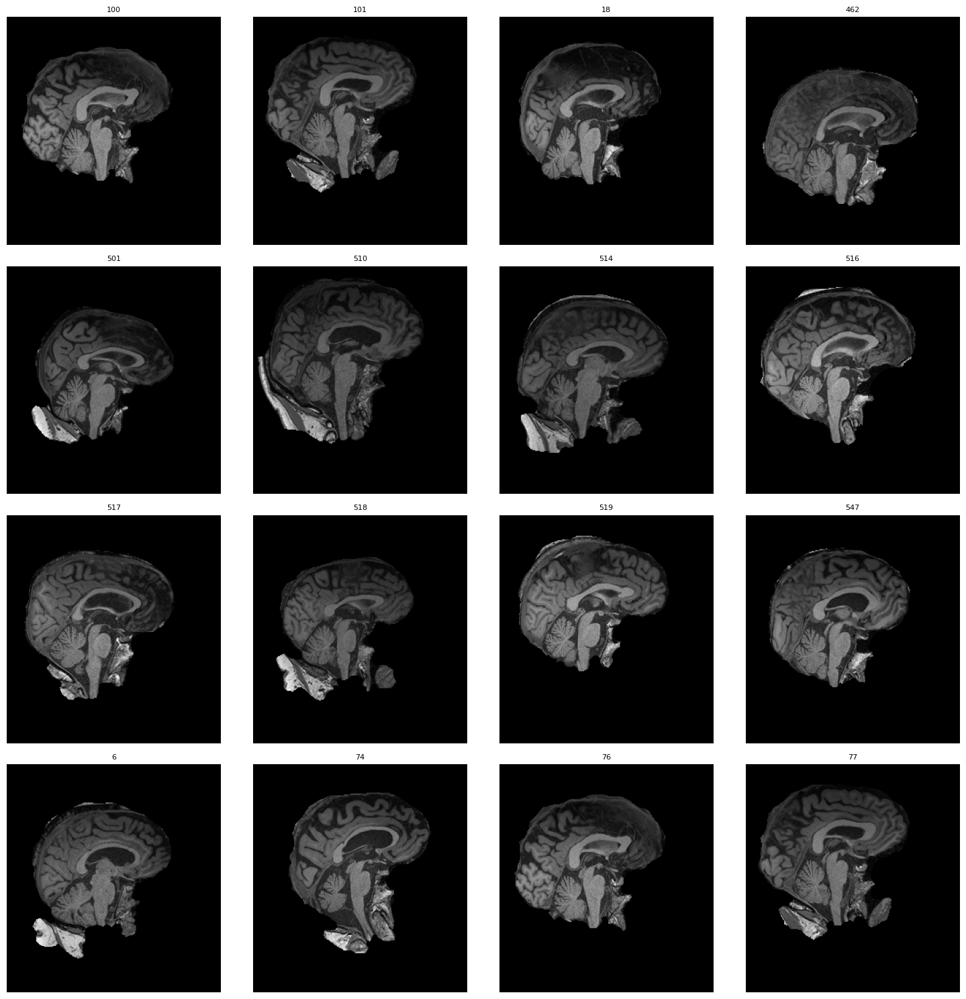

In [59]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208_3", 0, 16, axis=0)

In [53]:
#plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208_3", 0, 16, axis=0)
#plot_by_path()

# IT APPEARS CLEAR TO ME, THE G PARAMETER would of course cut out the neck and put more focus on the top of the image, problems occur however when the head is tilted backwards, so therefore

1. Rotate/centralize the head
2. Perform bet/skull removal using dynamically adjusted -p -g parameters
3. Rotate/centralize the brains
4. (Resize all images in the shape[0] folder 208 and 176 such that we can use both training data)

In [ ]:
#!/bin/bash

# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"  # Directory with your .nii.gz files
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_3"  # Directory to save preprocessed images

# Create output directory if it doesn't exist
mkdir -p "$OUTPUT_DIR"

# Function to process a single file
process_file() {
    BASENAME="$1"
    FILE="$INPUT_DIR/$BASENAME"
    
    if [ -f "$FILE" ]; then
        echo "Processing: $BASENAME"

        # Calculate mean intensity
        MEAN_INTENSITY=$(fslstats "$FILE" -M)

        # Set dynamic parameters
        if (( $(echo "$MEAN_INTENSITY < 80" | bc -l) )); then
            G_PARAM=-0.45
            F_PARAM=0.50
        elif (( $(echo "$MEAN_INTENSITY < 90" | bc -l) )); then
            G_PARAM=-0.35
            F_PARAM=0.5
        elif (( $(echo "$MEAN_INTENSITY < 100" | bc -l) )); then
            G_PARAM=-0.35
            F_PARAM=0.5
        elif (( $(echo "$MEAN_INTENSITY < 110" | bc -l) )); then
            G_PARAM=-0.35
            F_PARAM=0.5
        elif (( $(echo "$MEAN_INTENSITY < 150" | bc -l) )); then
            G_PARAM=-0.4
            F_PARAM=0.5
        else
            G_PARAM=-0.5
            F_PARAM=0.5
        fi

        # Skull stripping
        bet "$FILE" "$OUTPUT_DIR/${BASENAME%.nii.gz}_brain" -f "$F_PARAM" -g "$G_PARAM" -m
        echo "Finished processing: $BASENAME"
    else
        echo "File not found: $BASENAME"
    fi
}

export -f process_file
export INPUT_DIR OUTPUT_DIR  # Export variables for parallel

# Run in parallel for all .nii.gz files in the INPUT_DIR
echo "Starting parallel processing..."
parallel --jobs "$(nproc)" process_file ::: "$INPUT_DIR"/*.nii.gz

echo "All images processed. Results are in: $OUTPUT_DIR"

# Loop over all .nii.gz files in the input directory
#for FILE in "$INPUT_DIR"/*.nii.gz; do
    # Stop after the first 9 images
    #if [ "$COUNTER" -ge 9 ]; then
    #    break
    #fi

#    BASENAME=$(basename "$FILE" .nii.gz)


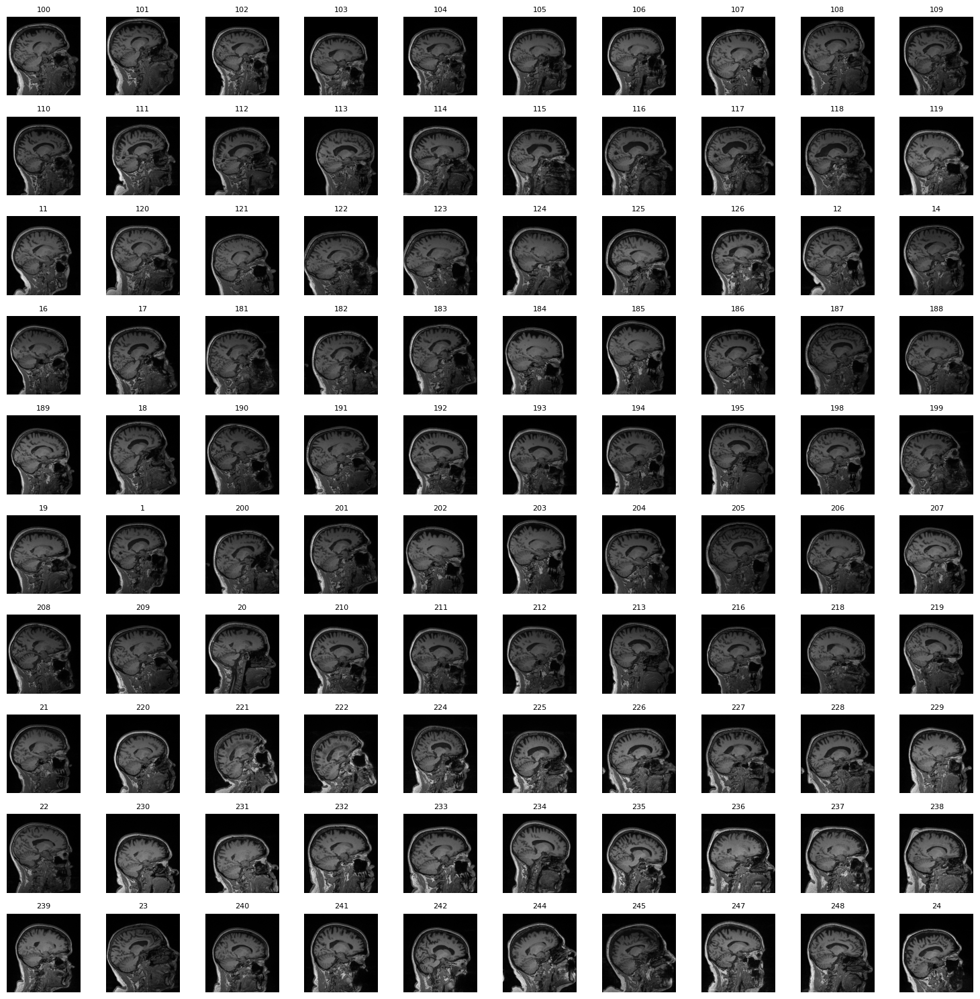

In [179]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\208", 0, 100, axis=1)

In [ ]:
#!/bin/bash

# Set directories
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/208"       # Directory with your .nii.gz files
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_4"   # Directory to save preprocessed images

# Create output directory if it doesn't exist
mkdir -p "$OUTPUT_DIR"

# Function to process a single file
process_file() {
    FILE="$1"
    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    

    G_PARAM=-0.8
    F_PARAM=0.3
    
    # Skull stripping using BET with dynamic -f value
    bet "$FILE" "$OUTPUT_DIR/${BASENAME%.nii.gz}_brain" -f "$F_PARAM" -g "$G_PARAM"

    #2. Bias field correction using FAST
    fast -B "$OUTPUT_DIR/${BASENAME}_brain.nii.gz"
    
    
    echo "Finished processing: $BASENAME"
}

export -f process_file  # Export the function for parallel execution

# Run in parallel for all .nii.gz files in the input directory
echo "Starting parallel processing..."
# find "$INPUT_DIR" -maxdepth 1 -type f -name "*.nii.gz" -print0 | parallel --jobs "$(nproc)" -0 process_file
# find "$INPUT_DIR" -maxdepth 1 -type f -name "*.nii.gz" | head -n 16 | parallel --jobs "$(nproc)" process_file {}

find "$INPUT_DIR" -maxdepth 1 -type f -name "*.nii.gz" | parallel --jobs "$(nproc)" process_file {}

echo "All images processed. Results are in: $OUTPUT_DIR"


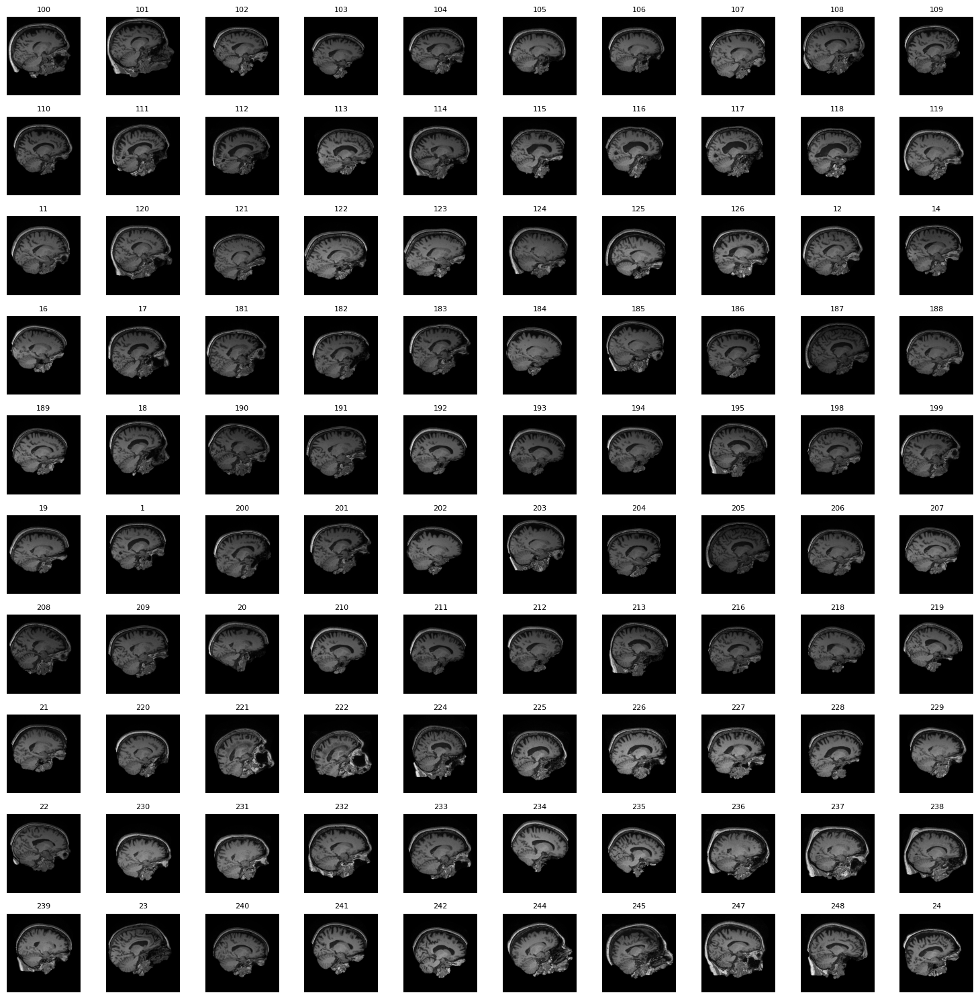

In [175]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\prepross_208_4", 0, 100, axis=1)

In [ ]:
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_4"       # Directory with your .nii.gz files
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/prepross_208_5"   # Directory to save preprocessed images

mkdir -p "$OUTPUT_DIR" # Create output directory if it doesn't exist

# Function to process a single file
process_file() {
    FILE="$1"
    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing: $BASENAME"
    
    
    G_PARAM=-0.1
    F_PARAM=0.2
    
    # Skull stripping using BET with dynamic -f value
    bet "$FILE" "$OUTPUT_DIR/${BASENAME%.nii.gz}_brain" -f "$F_PARAM" -g "$G_PARAM" -R
    
    echo "Finished processing: $BASENAME"
}

export -f process_file  # Export the function for parallel execution

# Run in parallel for all .nii.gz files in the input directory
echo "Starting parallel processing..."
#find "$INPUT_DIR" -maxdepth 1 -type f -name "*.nii.gz" | head -n 16 | parallel --jobs "$(nproc)" process_file {}
find "$INPUT_DIR" -maxdepth 1 -type f -name "*.nii.gz" | parallel --jobs "$(nproc)" process_file {}


echo "All images processed. Results are in: $OUTPUT_DIR"


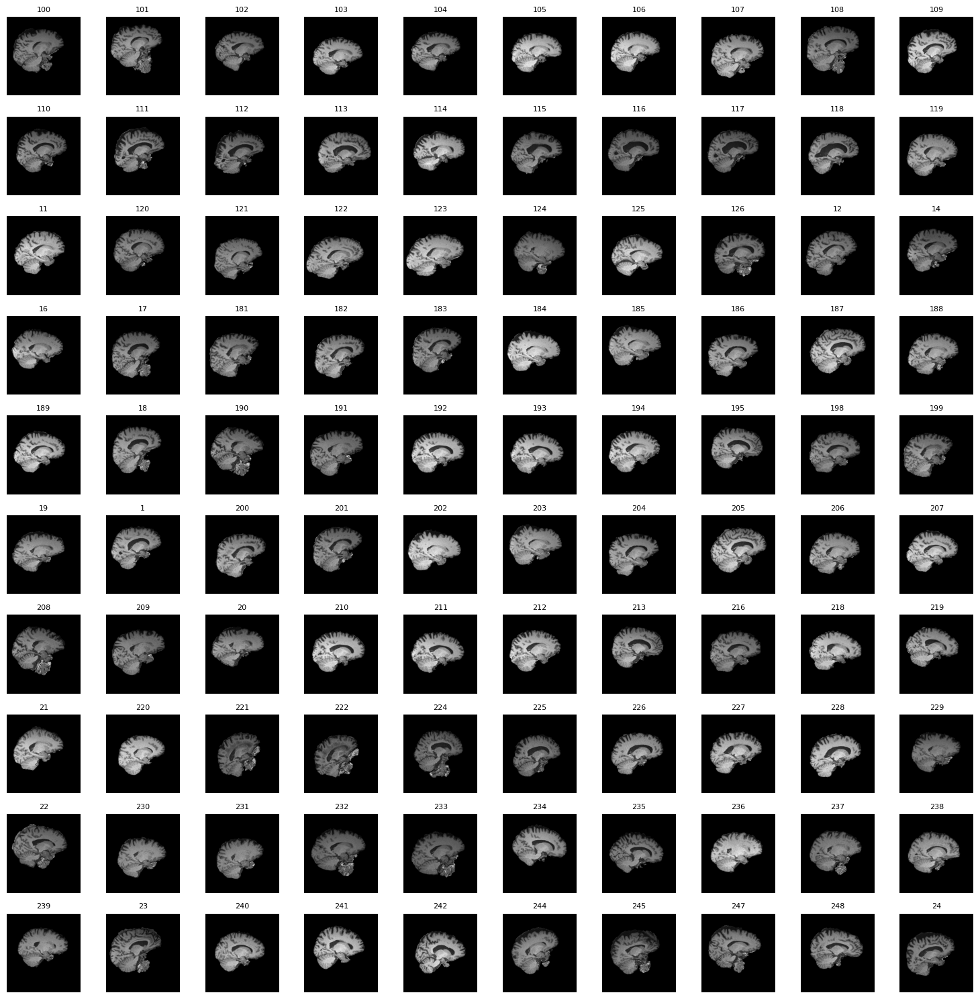

In [182]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\very_good_cuts", 0, 100, axis=1)

In [ ]:
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/very_good_cuts_fc"
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/very_spatial_norm"
# TEMPLATE="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/very_good_cuts/105_sub-ADNI007S6310_ses-M000_T1w_brain_brain.nii.gz"
TEMPLATE="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/very_good_cuts_fc/105_sub-ADNI007S6310_ses-M000_T1w_brain_brain_restore.nii.gz"

mkdir -p "$OUTPUT_DIR" # Create output directory if it doesn't exist

process_file() {
    #FILE="$1"
    #BASENAME=$(basename "$FILE" .nii.gz)
    #echo "Processing: $BASENAME"

    # Check if the file exists
    
    # Bias field correction using FAST
    # fast -B "$FILE" -o "$OUTPUT_DIR/${BASENAME}"
    # fast -B -o "$OUTPUT_DIR/${BASENAME}" "$FILE"


    # If spatial normalization is needed, uncomment the following block
    # FLIRT: Spatial normalization (optional, requires proper template setup)
    FILE="$1"
    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing file: $FILE"
    echo "Base name: $BASENAME"

    # FLIRT: Spatial normalization
    flirt -in "$FILE" \  # Use the input file directly
           -ref "$TEMPLATE" \
           -out "$OUTPUT_DIR/${BASENAME}_norm.nii.gz" 
           -omat "$OUTPUT_DIR/${BASENAME}_norm.mat"
}

export -f process_file  # Export the function for parallel execution

# Run the script in parallel for .nii.gz files
#find "$INPUT_DIR" -maxdepth 1 -type f -name "*.nii.gz"  | head -n 2 | parallel --jobs "$(nproc)" process_file {} 2>> error.log
#find "$INPUT_DIR" -maxdepth 1 -type f -name "*.nii.gz" | parallel --jobs "$(nproc)" process_file {}
# find "$INPUT_DIR" -maxdepth 1 -type f -name "*.nii.gz" | head -n 2 | parallel --jobs 4 process_file {}
find "$INPUT_DIR" -maxdepth 1 -type f -name "*_restore.nii.gz.nii.gz" | head -n 2 | while read FILE; do process_file "$FILE"; done


In [ ]:
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/very_good_cuts_fc"
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/very_spatial_norm"
# TEMPLATE="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/very_good_cuts/105_sub-ADNI007S6310_ses-M000_T1w_brain_brain.nii.gz"
TEMPLATE="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/very_good_cuts_fc/105_sub-ADNI007S6310_ses-M000_T1w_brain_brain_restore.nii.gz"
mkdir -p "$OUTPUT_DIR" # Create output directory if it doesn't exist

process_file() {
    # If spatial normalization is needed, uncomment the following block
    # FLIRT: Spatial normalization (optional, requires proper template setup)
    FILE="$1"
    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing file: $FILE"
    echo "Base name: $BASENAME"

    # FLIRT: Spatial normalization
    flirt -in "$FILE" \
           -ref "$TEMPLATE" \
           -out "$OUTPUT_DIR/${BASENAME}_norm.nii.gz" 
           -omat "$OUTPUT_DIR/${BASENAME}_norm.mat"
}

export -f process_file  # Export the function for parallel execution


find "$INPUT_DIR" -maxdepth 1 -type f -name "*_restore.nii.gz" | while read FILE; do process_file "$FILE"; done

# Run the script in parallel for .nii.gz files
#find "$INPUT_DIR" -maxdepth 1 -type f -name "*.nii.gz"  | head -n 2 | parallel --jobs "$(nproc)" process_file {} 2>> error.log
#find "$INPUT_DIR" -maxdepth 1 -type f -name "*.nii.gz" | parallel --jobs "$(nproc)" process_file {}
# find "$INPUT_DIR" -maxdepth 1 -type f -name "*.nii.gz" | head -n 2 | parallel --jobs 4 process_file {}
#find "$INPUT_DIR" -maxdepth 1 -type f -name "*_restore.nii.gz"  | head -n 20 | parallel --jobs "$(nproc)" process_file {} 2>> error.log
#find "$INPUT_DIR" -maxdepth 1 -type f -name "*.nii.gz"  | head -n 20 | parallel --jobs "$(nproc)" process_file {} 2>> error.log
#find "$INPUT_DIR" -maxdepth 1 -type f -name "*_restore.nii.gz" | head -n 20 | parallel --jobs "$(nproc)" process_file {}


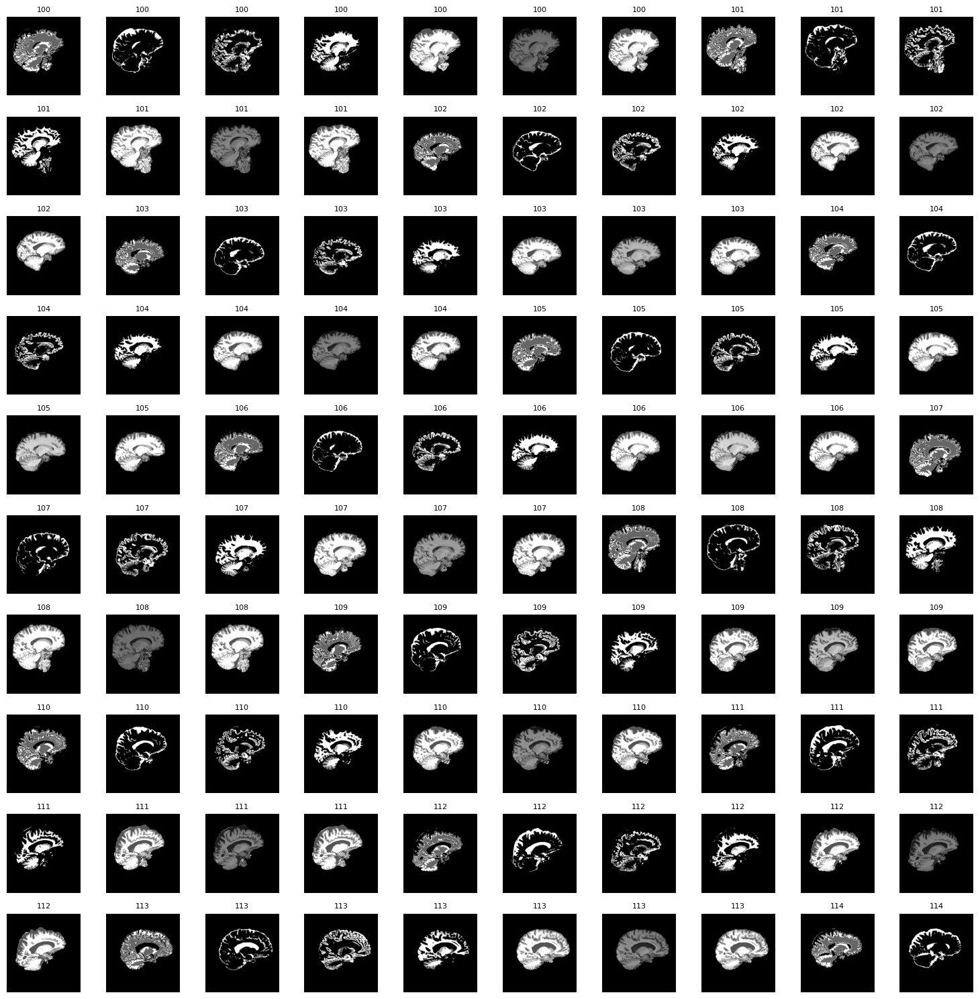

In [32]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\very_good_cuts_fc", 0, 100, axis=1)

In [31]:
path = r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\very_good_cuts_fc\100_sub-ADNI007S6120_ses-M000_T1w_brain_brain_restore.nii.gz"
img = nib.load(path)
img_data = img.get_fdata()
# plt.imshow(img_data[150, :, :].T, origin="lower")

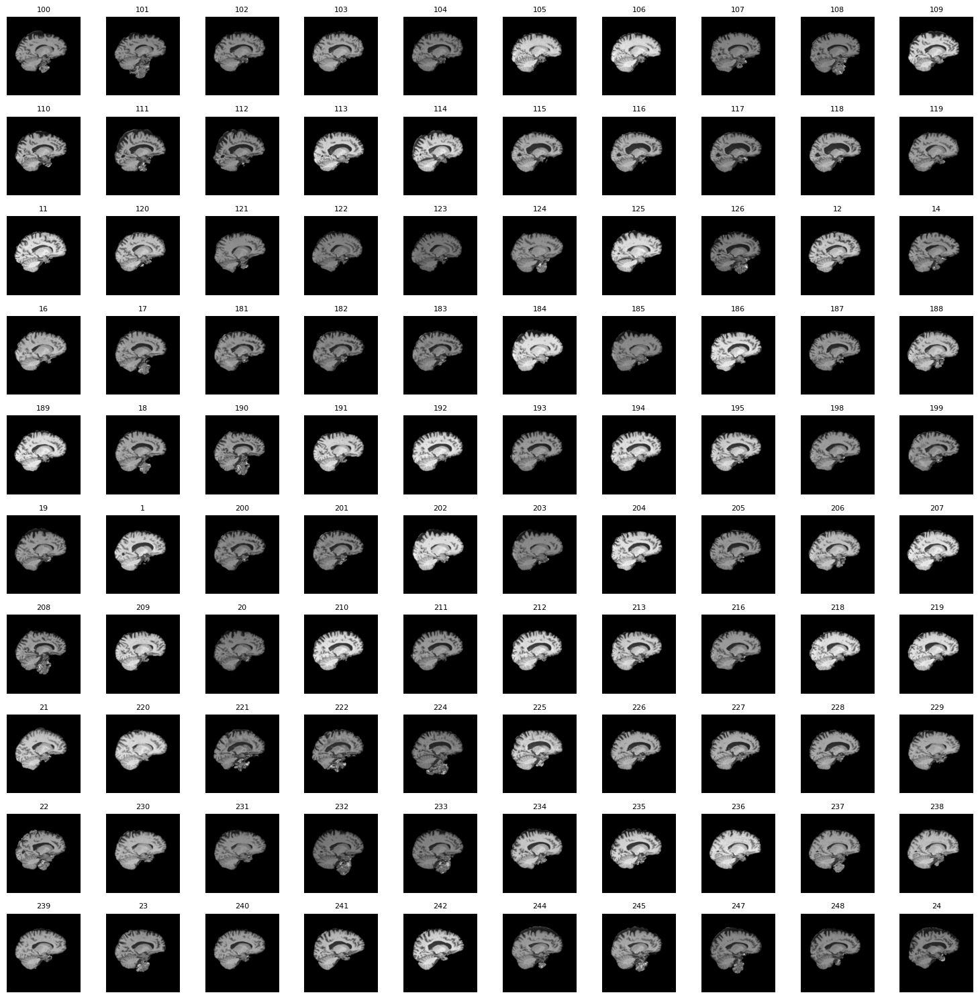

In [5]:
plot_middle_slices_in_range(r"C:\Users\kiran\Documents\_UIS\sem6\BACH\Data\very_spatial_norm", 0, 100, axis=1)

In [ ]:
INPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/very_good_cuts_fc"
OUTPUT_DIR="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/very_spatial_norm"
TEMPLATE="/mnt/c/Users/kiran/Documents/_UIS/sem6/BACH/Data/very_good_cuts_fc/105_sub-ADNI007S6310_ses-M000_T1w_brain_brain_restore.nii.gz"
mkdir -p "$OUTPUT_DIR"  # Create output directory if it doesn't exist

process_file() {
    FILE="$1"
    BASENAME=$(basename "$FILE" .nii.gz)
    echo "Processing file: $FILE"
    echo "Base name: $BASENAME"

    # FLIRT: Spatial normalization
    flirt -in "$FILE" \
           -ref "$TEMPLATE" \
           -out "$OUTPUT_DIR/${BASENAME}_norm.nii.gz" \
           -omat "$OUTPUT_DIR/${BASENAME}_norm.mat"
}

export -f process_file  # Export the function for parallel execution

# Run the script in parallel for .nii.gz files (with _restore suffix)
find "$INPUT_DIR" -maxdepth 1 -type f -name "*_restore.nii.gz" | head -n 20 | parallel --jobs "$(nproc)" process_file {}


1. Adjustable autoencoder,
tested on 
- normalized brain data, 
- augmented data, 
- diffent layer combinations, 
- filter size,
- kernel size, 
- latent_dim size, 
- metrics, 
- vae_model vs vae, 

TODO:
- skip connections
- unflatten latent space?
- vae fix bug
- test on more kernel size,  (16, (3,3,3)) -> 

2. preprocessing, 


Q: genetisk algoritmer for å utvikle netverk slik at en slipper å manuelt prøve seg frem. 

